# ***Import packages***

Before we begin, let's import all the necessary packages for this notebook:

In [1]:
# Download missing colab packages
!python -m pip install ingredient-parser-nlp
!pip install igraph
!pip install torch transformers
!pip install GoogleNews
!pip install newspaper3k
!pip install hugchat


# Import packages
import re
import gc
import json
import time
import itertools
import requests
import nltk
import torch
import numpy as np
import pandas as pd
import seaborn as sns
import missingno as msno
import networkx as nx
import igraph as ig
from scipy import stats
from plotly import express as px
from typing import Union
from skimage import io
from bs4 import BeautifulSoup
from tqdm.notebook import tqdm
from ingredient_parser import parse_ingredient
from matplotlib import pyplot as plt
from operator import itemgetter
from pprint import pprint
from wordcloud import WordCloud
from transformers import (RobertaTokenizer, RobertaModel, AutoTokenizer,
                          AutoModelForSequenceClassification)
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import (accuracy_score, roc_auc_score,  confusion_matrix,
                             ConfusionMatrixDisplay)
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity
from hugchat import hugchat
from hugchat.login import Login
from newspaper import Config, Article
from GoogleNews import GoogleNews


# Download nltk packages
nltk.download("averaged_perceptron_tagger")
nltk.download("punkt")

# Apply tqdm to pandas
tqdm.pandas()

# Set plotting theme
sns.set_context("notebook")

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 630.7/630.7 kB 42.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 993.5/993.5 kB 72.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.3/3.3 MB 64.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.2/7.2 MB 57.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 268.8/268.8 kB 31.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 61.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 37.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 293.8/293.8 kB 12.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.1/211.1 kB 13.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 81.1/81.1 kB 13.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 93.3/93.3 kB 11.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.4/7.4 MB 50.7 MB/s eta 0:00:

[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Unzipping taggers/averaged_perceptron_tagger.zip.
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


# ***Question 1***

## ***Unlimited resources solution to the problem - verbal explanation***
If I had unlimited resources (money, labour, computing, etc.) I would suggest the following solution for addressing the problem of the opioid epidemic.

Data is the main issue in this question (as in all data science problems). I would gather extensive data from various sources, including healthcare providers, pharmacies, law enforcement agencies, employment databases, demographic information, and prescription records. Utilise advanced data integration techniques to combine and organise the collected data effectively. For this task I can buy data, get the labour force needed to sort the data in order to get the most quality data there is.

Regarding hotspot Identification I would utilise the most advanced machine learning algorithms, not limiting the amount of information and computational aspects, to identify areas or regions suffering from the opioid epidemic. I would develop new softwares to present data on maps in the most efficient and visible manner. Regarding changes (demographic, crime, unemployment, prescriptions etc.)  I would utilise statistical methods and data visualisation techniques to identify and present changes over time with the assistance of the best data people which I can pay them.

In order to make the analysis more convincing and accessible I would develop a user-friendly interface for accessing and interacting with the system which provides visualisations, such as interactive maps, charts, and graphs, to present the findings effectively. In addition I would generate comprehensive reports summarising the results of the analyses

Lastly, I think another important aspect is up-to-date so this will be run every month and Continuously be improved.

During my proof of concept, I will use multiple public datasets that have everything most of what I need, but the quality is lower than our hypothetical dataset. As in our hypothetical case, I will run algorithms and limit them due to a lack of resources but try to get as much information as possible.


## ***Section 1.0 - Dataset***

In order to answer this question, I selected multiple datasets from multiple sources and combined them. The datasets:

- [Opioids in the US: CDC Drug Overdose Deaths](https://www.kaggle.com/datasets/craigchilvers/opioids-in-the-us-cdc-drug-overdose-deaths)
- [The Collection of Really Great, Interesting, Situated Datasets State Crime](https://corgis-edu.github.io/corgis/csv/state_crime/)
- [USA Unemployment & Education Level](https://www.kaggle.com/datasets/valbauman/student-engagement-online-learning-supplement?select=education.csv)
- [US Census and Election Results (2000-2020)](https://www.kaggle.com/datasets/minhbtnguyen/us-census-for-election-predictions-20002020)
- [Medicare Part D Opioid Prescribing Rates - by Geography Data Dictionary](https://data.cms.gov/resources/medicare-part-d-opioid-prescribing-rates-by-geography-data-dictionary)


Let's read the data:

In [2]:
# Config kaggle
!mkdir /root/.kaggle/
api_token = {"username":"","key":""}
with open("/root/.kaggle/kaggle.json", "w") as file:
  json.dump(api_token, file)
!chmod 600 /root/.kaggle/kaggle.json
# Download data
!kaggle datasets download -d craigchilvers/opioids-in-the-us-cdc-drug-overdose-deaths
!kaggle datasets download -d valbauman/student-engagement-online-learning-supplement
!kaggle datasets download -d minhbtnguyen/us-census-for-election-predictions-20002020
url = "https://data.cms.gov/data-api/v1/dataset/34594975-258c-44ee-993c-847278e1954a/data-viewer?_format=csv"
r = requests.get(url, stream=True)
with open("Prescribing.zip", 'wb') as fd:
    for chunk in r.iter_content(chunk_size=128):
        fd.write(chunk)
# Unzip data
!unzip -o opioids-in-the-us-cdc-drug-overdose-deaths.zip
!unzip -o student-engagement-online-learning-supplement.zip
!unzip -o us-census-for-election-predictions-20002020.zip
!unzip -o Prescribing.zip
# Read Data
state_overdose_2013_2019 = pd.read_csv("/content/CDC Injury Center Drug Overdose Deaths.csv", encoding = "ISO-8859-1")
state_crime_1960_2019 = pd.read_csv("https://corgis-edu.github.io/corgis/datasets/csv/state_crime/state_crime.csv")
state_unemployment_2013_2020 = pd.read_csv("/content/unemployment.csv", thousands=',')
demographics = pd.read_csv("county_census_and_election_result.csv")
prescribers = pd.read_csv("Medicare_Part_D_Opioid_Prescribing_Rates_by_Geography_2021.csv")

  0% 0.00/4.00k [00:00<?, ?B/s]
100% 4.00k/4.00k [00:00<00:00, 9.91MB/s]
 96% 2.00M/2.08M [00:01<00:00, 2.24MB/s]
100% 2.08M/2.08M [00:01<00:00, 2.02MB/s]
100% 491k/491k [00:00<00:00, 682kB/s]
100% 491k/491k [00:00<00:00, 681kB/s]
Archive:  opioids-in-the-us-cdc-drug-overdose-deaths.zip
  inflating: CDC Injury Center Drug Overdose Deaths.csv  
Archive:  student-engagement-online-learning-supplement.zip
  inflating: UIC_codes.csv           
  inflating: education.csv           
  inflating: locale_user_manual.pdf  
  inflating: unemployment.csv        
Archive:  us-census-for-election-predictions-20002020.zip
  inflating: county_census_and_election_result.csv  
  inflating: meta_data.csv           
Archive:  Prescribing.zip
  inflating: Medicare_Part_D_Opioid_Prescribing_Rates_by_Geography_2021.csv  


Next, let's combine the datasets:

In [3]:
# Get opioid overdose deaths relevant data
dfs = []
for column in state_overdose_2013_2019.columns:
    if "Number of Deaths" in column:
        temp_df = state_overdose_2013_2019[
            ["State", "State Abbreviation", column]].copy()
        temp_df["Year"] = int(column.split(" ")[0])
        temp_df.rename(columns={column: "Deaths"}, inplace=True)
        dfs.append(temp_df)
state_opioid_overdose = pd.concat(dfs)

# Get unemployment relevant data
dfs = []
for column in state_unemployment_2013_2020.columns:
    if "Unemployed" in column:
        temp_df = state_unemployment_2013_2020[
            ["State", column]].copy()
        temp_df["Year"] = int(column.split("_")[1])
        temp_df.rename(columns={column: "Unemployed"}, inplace=True)
        dfs.append(temp_df)
state_unemployment = pd.concat(dfs)
state_unemployment.rename(columns={"State": "State Abbreviation"}, inplace=True)
state_unemployment = state_unemployment.groupby(by=["State Abbreviation", "Year"]).sum().reset_index()

# Merge opioid overdose deaths with crime rate
opioid_df = pd.merge(
    state_opioid_overdose,
    state_crime_1960_2019[state_crime_1960_2019["Year"].between(2013, 2019)],
    on=["State", "Year"])

# Merge opioid overdose deaths and crime rate with unemployment
opioid_df = pd.merge(
    opioid_df,
    state_unemployment[state_unemployment["Year"].between(2013, 2019)],
    on=["State Abbreviation", "Year"])

# Create new column of deaths by population
opioid_df["Deaths per 100,000 population"] = (
    opioid_df["Deaths"] / opioid_df["Data.Population"] * 100000)

# Create new column of Unemployment by population
opioid_df["Unemployment per 100,000 population"] = (
    opioid_df["Unemployed"] / opioid_df["Data.Population"] * 100000)

## ***Section 1.1 - Opioid epidemic hot spots***

Let's visualize the opioid epidemic for all US:

In [4]:
# Plot hot spots in the US suffering from the opioid epidemic
plot_data = opioid_df.sort_values("Year")
fig = px.choropleth(
    plot_data, locationmode="USA-states", scope="usa",
    locations="State Abbreviation", color="Deaths per 100,000 population",
    hover_name="State", hover_data=["Deaths per 100,000 population"],
    animation_frame="Year",
    range_color=(min(plot_data["Deaths per 100,000 population"]),
                 max(plot_data["Deaths per 100,000 population"])))
fig.update_layout(title_text = "Opioid epidemic US (2013-2019)", title_x=0.5)
fig.show()

Next, let's look at the trend opioid epidemic for all US per state:

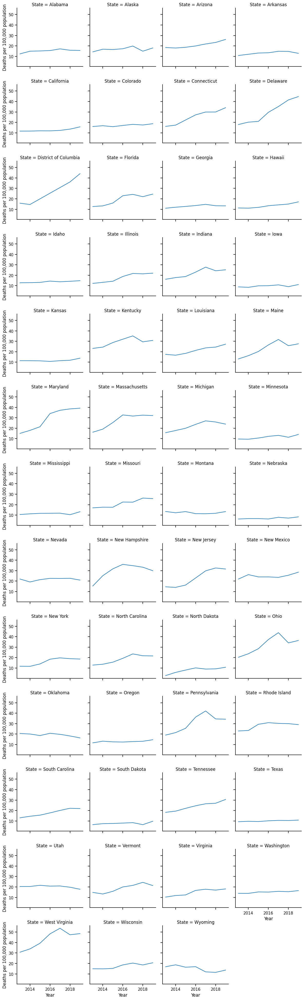

In [5]:
g = sns.FacetGrid(opioid_df, col="State", col_wrap=4)
g.map(sns.lineplot, "Year", "Deaths per 100,000 population")
plt.show()

Looking at the two visualization above its hard to understand which states suffer from the opioid epidemic and who is a hot spot. Let's get all the states that are hor spot. I define a hot spot by taking states that their deaths by opioid against years trend is bigger then the median deaths by opioid against years of all states:

In [6]:
# Get opioid hot spot states
state_deaths_trend = {}
for group_index, group in opioid_df.groupby("State"):
    year, deaths = group.dropna().sort_values("Year")[[
        "Year", "Deaths per 100,000 population"]].T.values
    slope, intercept, r_value, p_value, std_err = stats.linregress(
        year, deaths)
    state_deaths_trend[group_index] = slope
threshold = np.percentile(list(state_deaths_trend.values()), 50)
hot_spots = [
    state for state, trend in state_deaths_trend.items() if trend > threshold]

Let's visualize the opioid epidemic for hot spots in the US:

In [7]:
# Plot hot spots in the US suffering from the opioid epidemic
plot_data = opioid_df[opioid_df.State.isin(hot_spots)].sort_values("Year")
fig = px.choropleth(plot_data,
                    locationmode="USA-states",
                    scope="usa",
                    locations="State Abbreviation",
                    color="Deaths per 100,000 population",
                    hover_name="State",
                    hover_data=["Deaths per 100,000 population"],
                    animation_frame="Year")
fig.update_layout(
    title_text = ("Hot spots in the US suffering "
    "from the opioid epidemic (2013-2019)"), title_x=0.5)
fig.show()

Let's add a column representing opioid hot spot states:

In [8]:
# Add column hot spots
opioid_df.loc[opioid_df.State.isin(hot_spots), "hotspot"] = "hotspot"
opioid_df.loc[~opioid_df.State.isin(hot_spots), "hotspot"] = "non-hotspot"

## ***Section 1.2 - Demographic changes***

Let's get demographic information for hot spot states:

In [9]:
# Get mapping between state code to state
state_code_2_state_name = pd.Series(opioid_df.State.values,index=opioid_df["State Abbreviation"]).to_dict()

# Get mapping between fips to state
fips_2_state = pd.read_csv("https://raw.githubusercontent.com/kjhealy/us-county/master/data/census/fips-by-state.csv", encoding = "ISO-8859-1")
fips_2_state = pd.Series(fips_2_state.state.values,index=fips_2_state.fips.values).to_dict()
fips_2_state = {key: state_code_2_state_name[val] for key, val in fips_2_state.items()}

# Filter data by year and state
demographics = demographics[demographics.county_fips.isin(fips_2_state.keys())]
demographics = demographics[demographics.year.between(2013,2019)]

# Get state from fips
demographics["State"] = demographics.county_fips.apply(
    lambda x: fips_2_state[x])

# Rename column to meaningful columns
demographics.rename(
    columns={'year': 'Year',
             'inctot': 'Average Annual Income of Individuals',
             'mortamt1': 'Average Amount Of Mortgage Payments',
             'avrg_age': 'Average Age',
             'ftotinc': 'Average Annual Total Family Income',
             'foodstmp_1_freq': 'Percentage Foodstamps Receivers',
             'foodstmp_2_freq': 'Percentage Foodstamps non Receivers',
             'sex_2_freq': 'Percentage of Females',
             'sex_1_freq': 'Percentage of Males',
             'marst_5_freq': 'Percentage of Widowed',
             'marst_6_freq': 'Percentage of Never Married',
             'marst_1_freq': 'Percentage of Married Spouse Present',
             'marst_4_freq': 'Percentage of Divorced',
             'marst_3_freq': 'Percentage of Seperated',
             'marst_2_freq': 'Percentage of Married Spouse Absent',
             'race_1_freq': 'Percentage of White',
             'race_2_freq': 'Percentage of Black/African American',
             'race_7_freq': 'Percentage of Other Race',
             'race_8_freq': 'Percentage of Two major Races',
             'race_5_freq': 'Percentage of Japanese',
             'race_6_freq': 'Percentage or Other Asian',
             'race_3_freq': 'Percentage of American Indian or Alaska Native',
             'race_4_freq': 'Percentage of Chinese',
             'race_9_freq': 'Percentage of Three or More Races',
             'ctz_stat_1_freq': 'Percentage of US Citizen',
             'ctz_stat_3_freq': 'Percentage of Non US Citizen',
             'ctz_stat_2_freq': 'Percentage of Naturalized Citizen',
             'lang_1_freq': 'English Spoken at Home (%)',
             'lang_2_freq': 'Another Language Spoken at Home (%)',
             'educ_attain_2.0_freq': 'Percentage of Some College or Bachelor Degree',
             'educ_attain_1.0_freq': 'Percentage of High School or Lower Education',
             'educ_attain_3.0_freq': 'Percentage of Masters or Professional Certificate',
             'educ_attain_4.0_freq': 'Percentage of Doctoral Degree',
             'empstat_1.0_freq': 'Percentage of Employed',
             'empstat_3.0_freq': 'Percentage of Not In The Labor Force',
             'empstat_2.0_freq': 'Percentage of Unemployed'}, inplace=True)

# Drop non meaningful columns
demographics.drop(['state_po', 'county_name', "democrat", "green",
                   "liberitarian", "other", "republican", "winner", "county_fips"],
                  axis=1, inplace=True)

# Get demographics fro hot spots states only
hot_spots_demographics = demographics.loc[demographics.State.isin(hot_spots)]

Lets visualize combined demographic information for hot spot states:

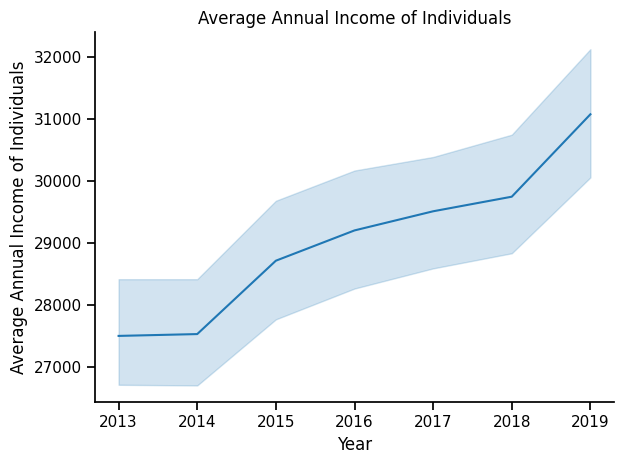

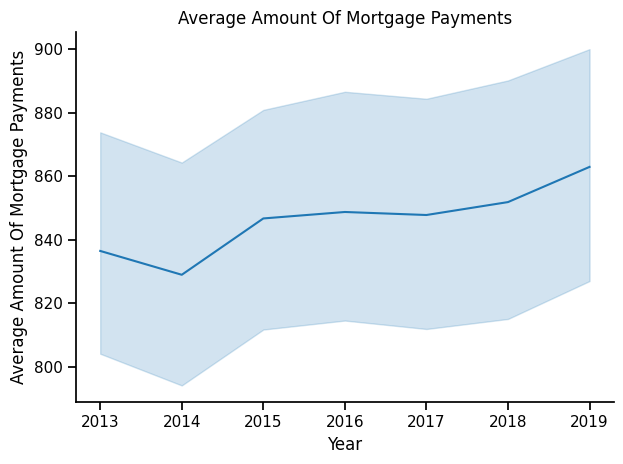

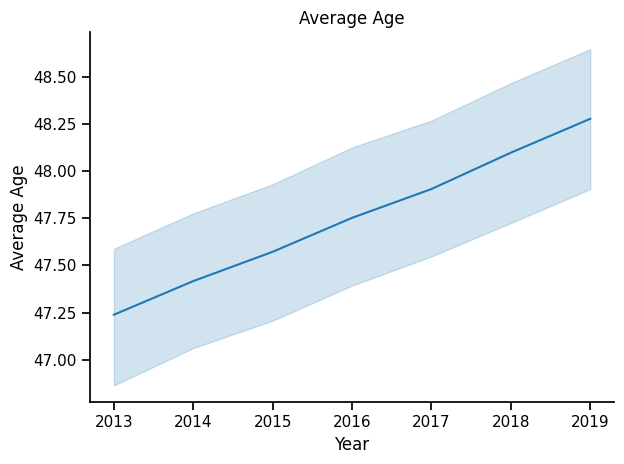

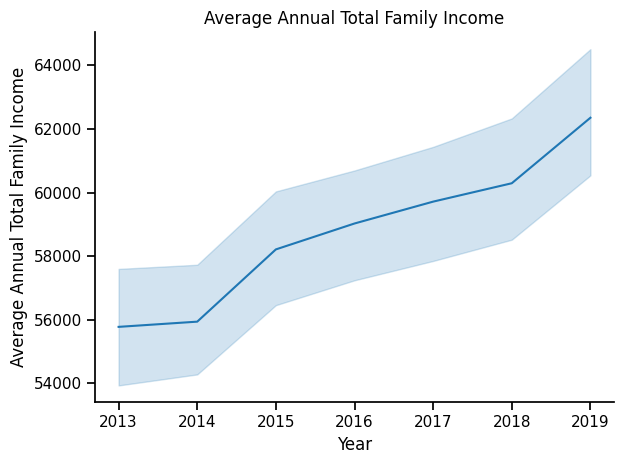

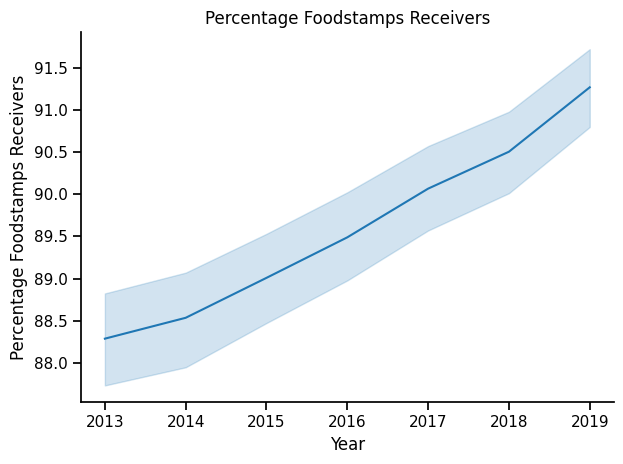

...

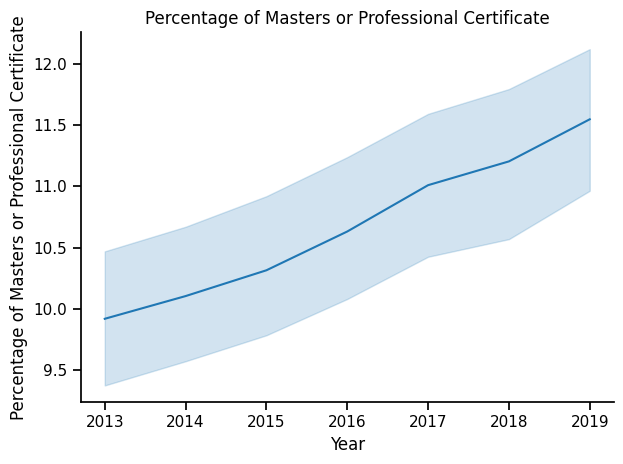

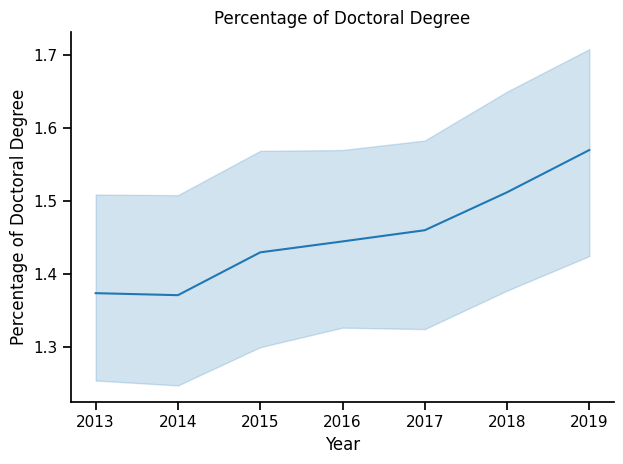

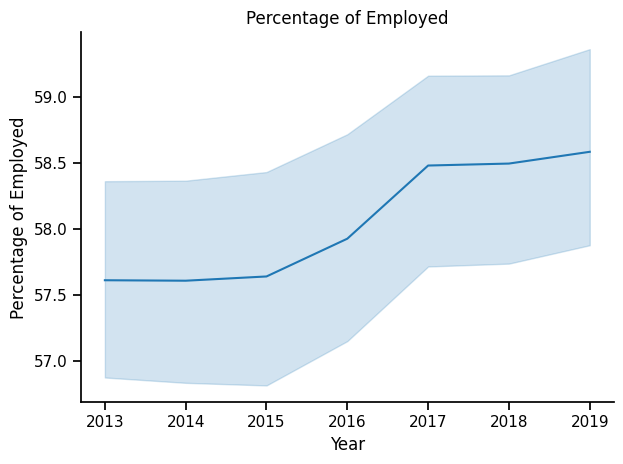

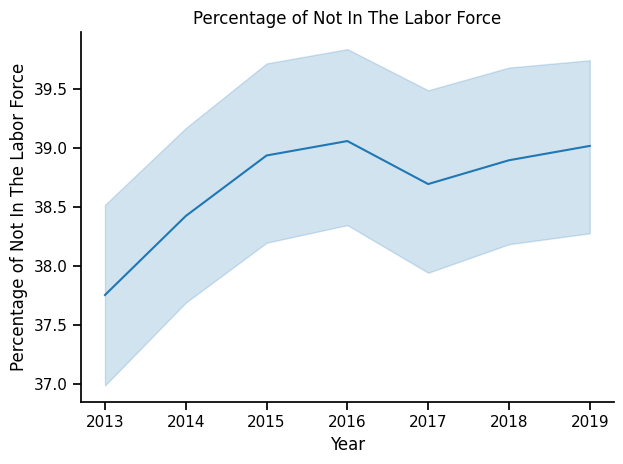

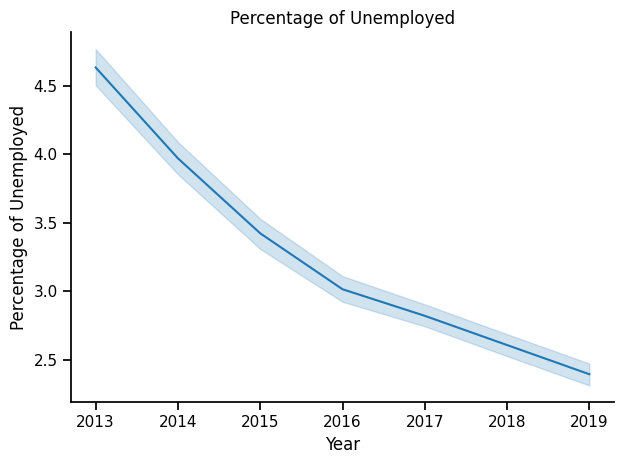

In [10]:
# Plot combined demographic information for hot spot states
for column in hot_spots_demographics.columns.drop(["Year", "State"]):
    sns.lineplot(hot_spots_demographics, x="Year", y=column)
    plt.title(f"{column}")
    sns.despine()
    plt.tight_layout()
    plt.show()
    print("\n\n")

Lets visualize demographic information for each hot spot state:

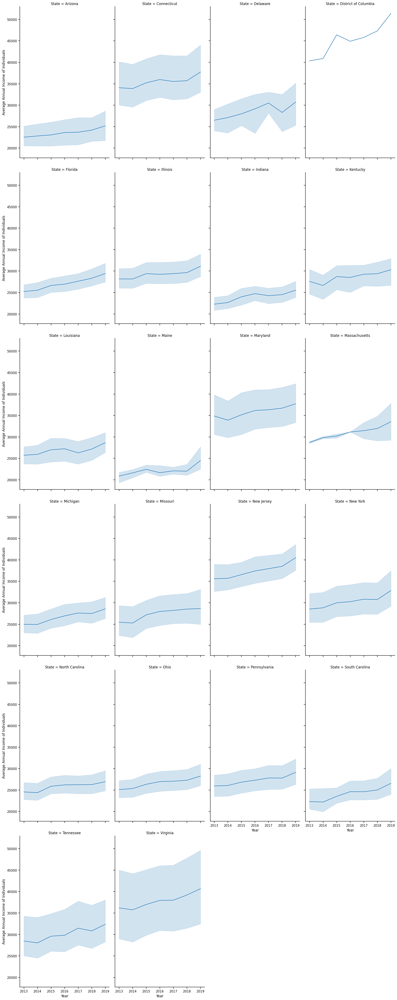

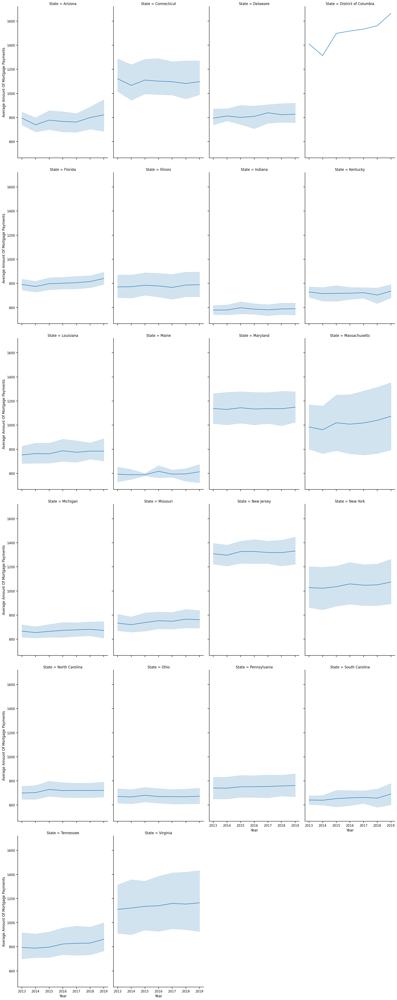

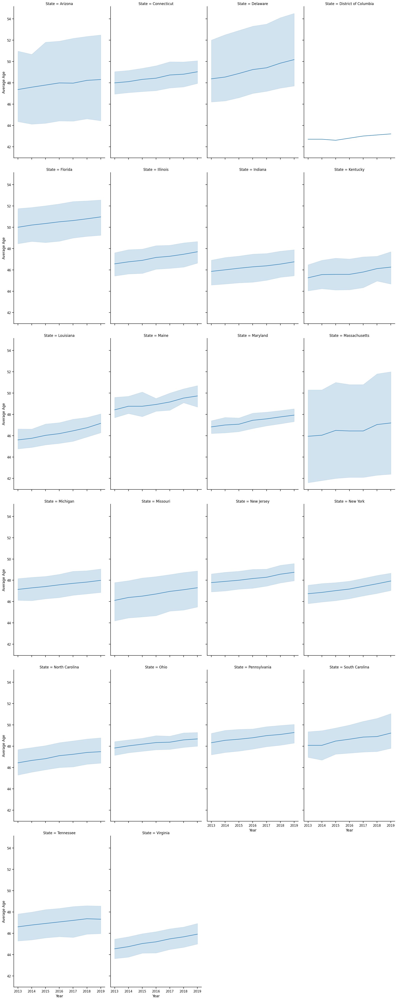

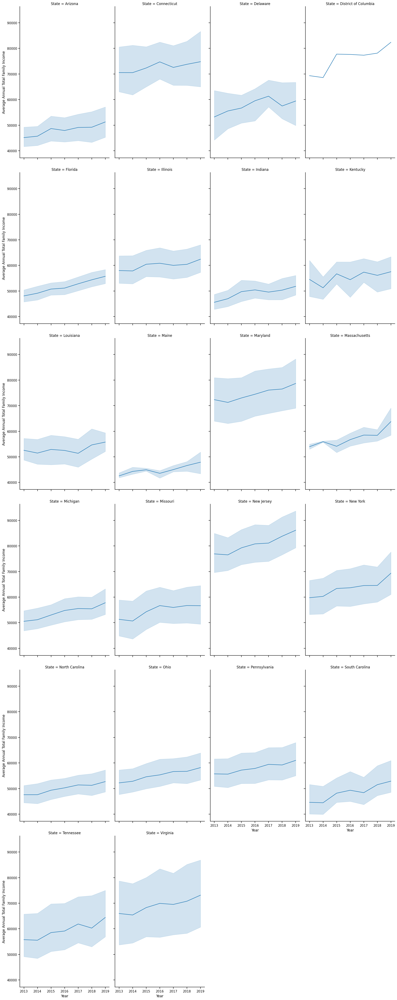

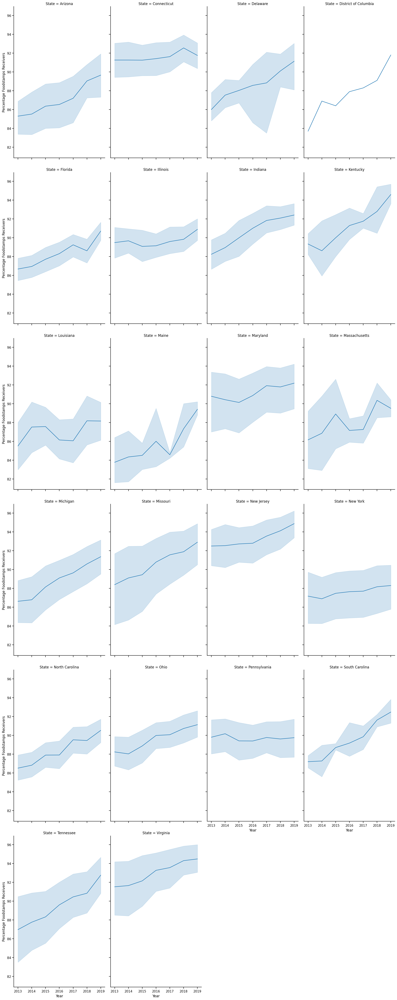

...

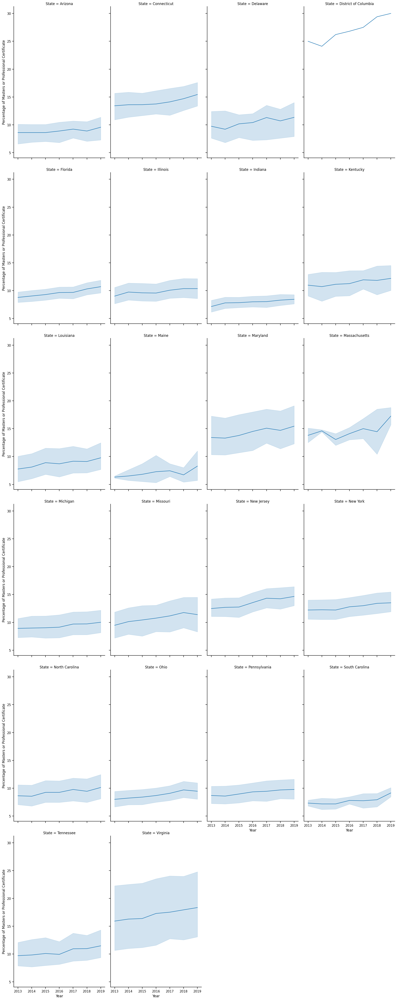

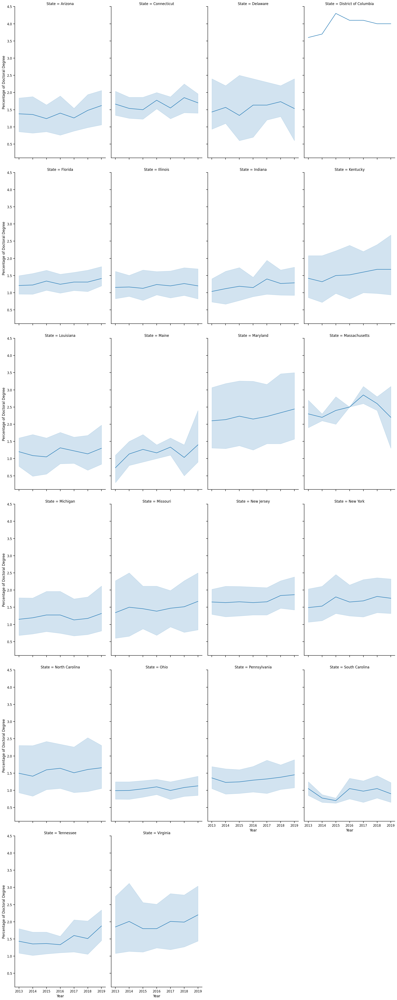

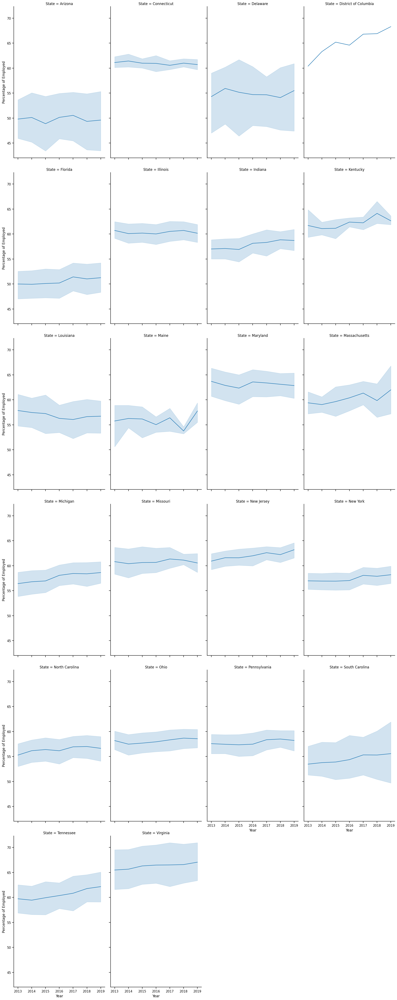

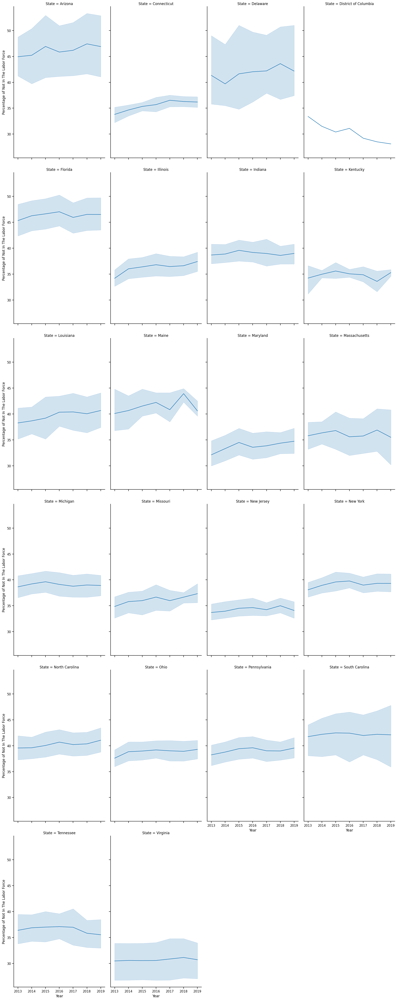

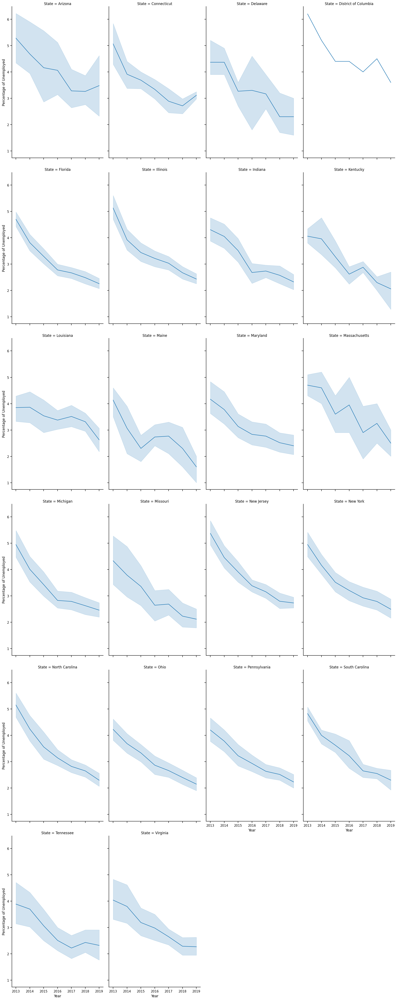

In [11]:
# Plot demographic information for each hot spot state
for column in hot_spots_demographics.columns.drop(["Year", "State"]):
    g = sns.FacetGrid(hot_spots_demographics, col="State", col_wrap=4, height=8, aspect=0.6)
    g.map(sns.lineplot, "Year", column)
    plt.show()
    print("\n\n")

## ***Section 1.3 - Crime rate and Unemployment***

Let's visualize the the comparison of unemployment/crime rates in hot spots vs. non-hot spots:

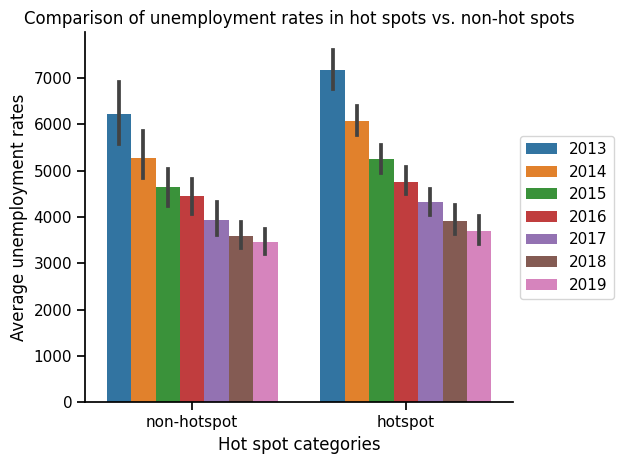

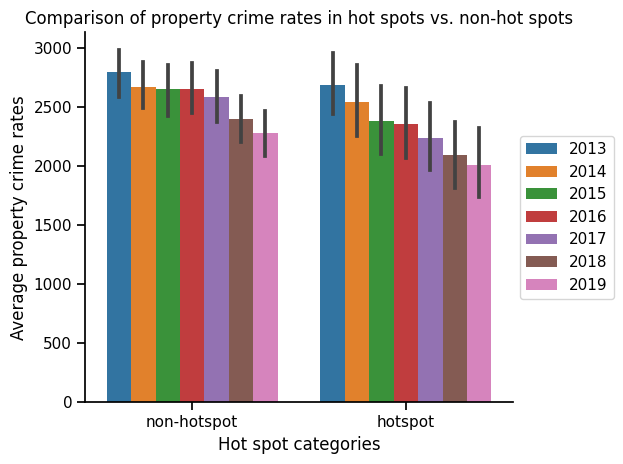

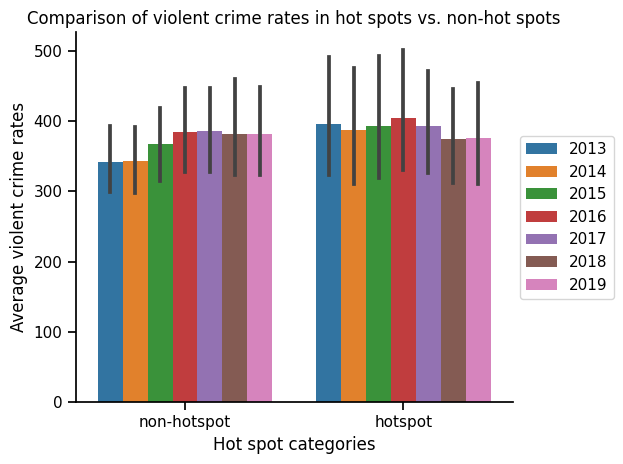

In [12]:
# Define column to plot name mapping for loop
columns_2_plot_name = {
    "Unemployment per 100,000 population": "unemployment rates",
    "Data.Rates.Property.All": "property crime rates",
    "Data.Rates.Violent.All": "violent crime rates"
    }
# Plot the comparison of unemployment\crime rates in hot spots vs. non-hot spots
for column, plot_name in columns_2_plot_name.items():
    ax = sns.barplot(opioid_df, x="hotspot", y=column, hue="Year")
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    plt.title(f"Comparison of {plot_name} in hot spots vs. non-hot spots")
    plt.xlabel("Hot spot categories")
    plt.ylabel(f"Average {plot_name}")
    sns.despine()
    plt.tight_layout()
    plt.show()
    print("\n\n")

Looking at the figures, we can see the following:

- Unemployment rate in hot spots and non-hot spots are decreasing. It looks like still hot spots have more unemployment.
- Property crime rate in hot spots and non-hot spots are decreasing. It looks like non-hot spots have more property crime.
- Violent crime rate in hot spots and non-hot spots are stable more or less. It looks like non-hot spots have the same violent crime as hot spots.

Let's visualize the unemployment/crime rates in each state for a deeper understanding:

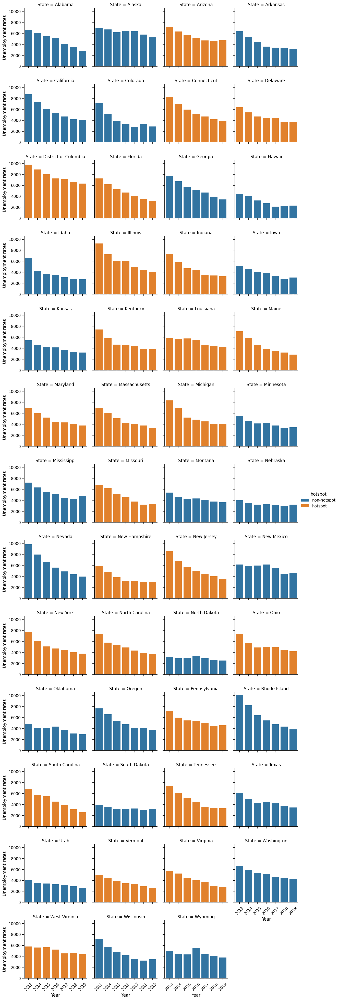

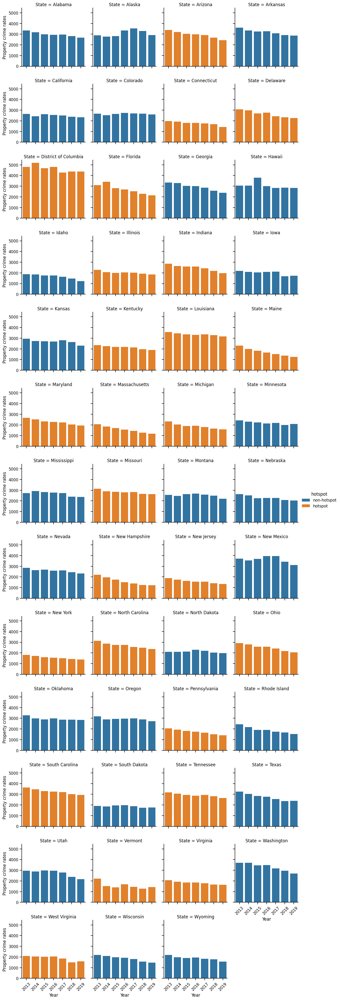

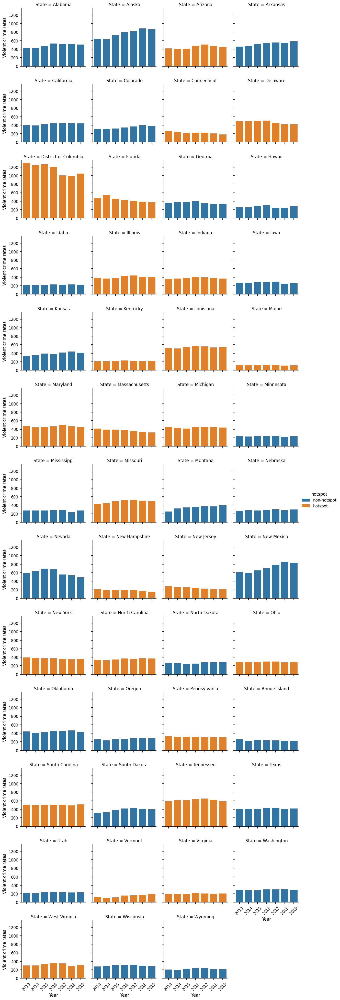

In [13]:
# Define column to plot name mapping for loop
columns_2_plot_name = {
    "Unemployment per 100,000 population": "unemployment rates",
    "Data.Rates.Property.All": "property crime rates",
    "Data.Rates.Violent.All": "violent crime rates"
    }
# Plot the unemployment\crime rates in states by hot spots vs. non-hot spots
for column, plot_name in columns_2_plot_name.items():
    g = sns.FacetGrid(opioid_df, col="State", col_wrap=4, hue="hotspot")
    g.map_dataframe(sns.barplot, x="Year", y=column)
    g.add_legend()
    for ax in g.axes.flat:
        ax.set_ylabel(plot_name.capitalize())
        plt.setp(ax.get_xticklabels(), rotation=45)
    plt.show()
    print("\n\n")

Looking at the figure we can see the following:
- Unemployment rates are decreasing in all states no matter if its a hot spot or not.
- Property crime rate is pretty stable no matter if its a hot spot or not. And some hot spots even have a decreasing trend in property crime (Maryland, New Hampshire etc.)
-  Violent crime rate is pretty stable no matter if its a hot spot or not. And some not-hot spots even have a increasing trend in property crime (Alaska, New Mexico etc.)

So its hard to decide if the opioid epidemic has any influence on unemployment/crime rates in hot spots.

## ***Section 1.5 - Prescriptions***

Let's get prescribers information for states:

In [14]:
# Get prescribers information for states
prescribers = prescribers[prescribers["Prscrbr_Geo_Lvl"] == "State"]
prescribers = prescribers[prescribers["Year"].between(2013, 2019)]
prescribers.loc[prescribers.Prscrbr_Geo_Desc.isin(hot_spots), "hotspot"] = "hotspot"
prescribers.loc[~prescribers.Prscrbr_Geo_Desc.isin(hot_spots), "hotspot"] = "non-hotspot"

Let's visualize each trend for hot spot and non hot spot states:

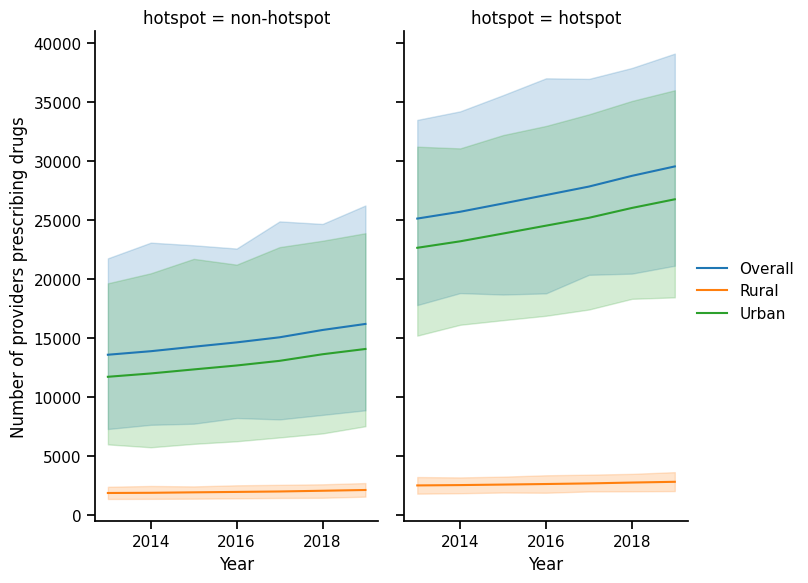

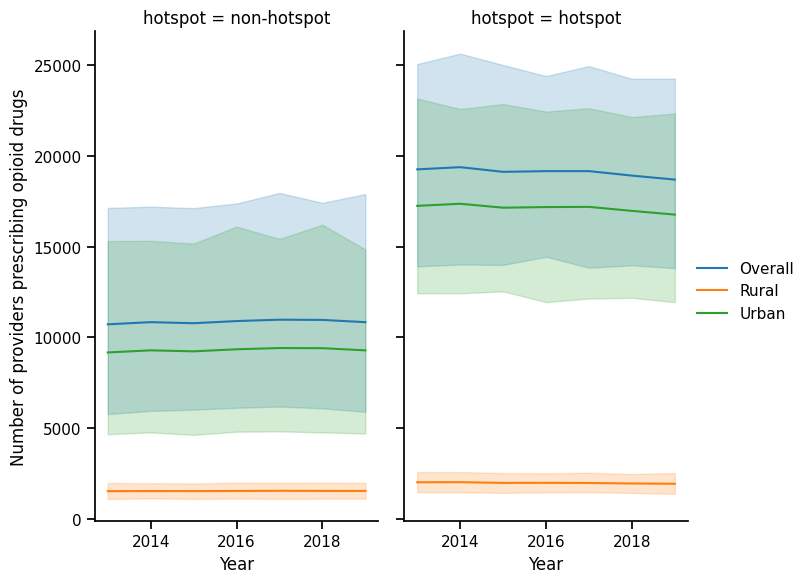

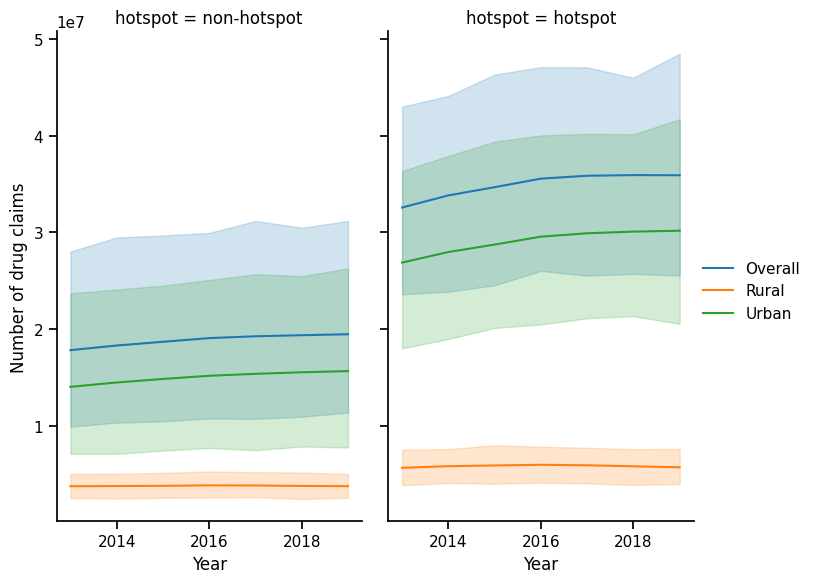

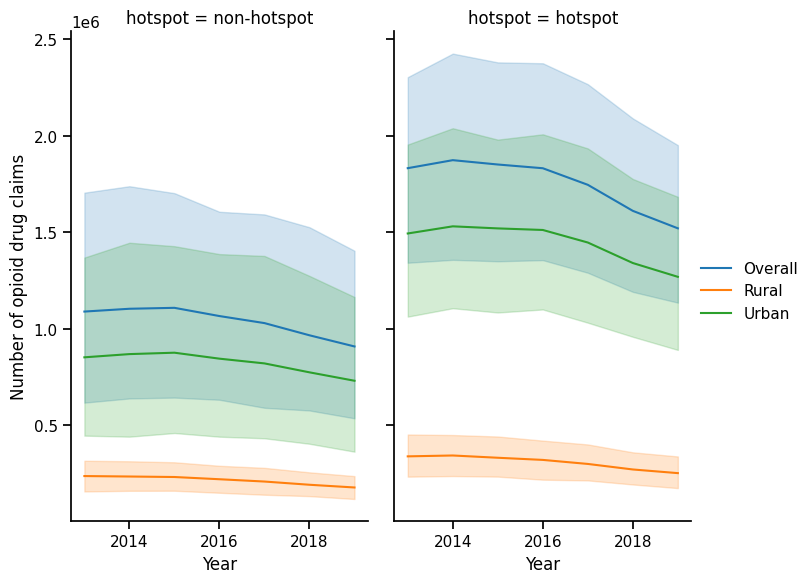

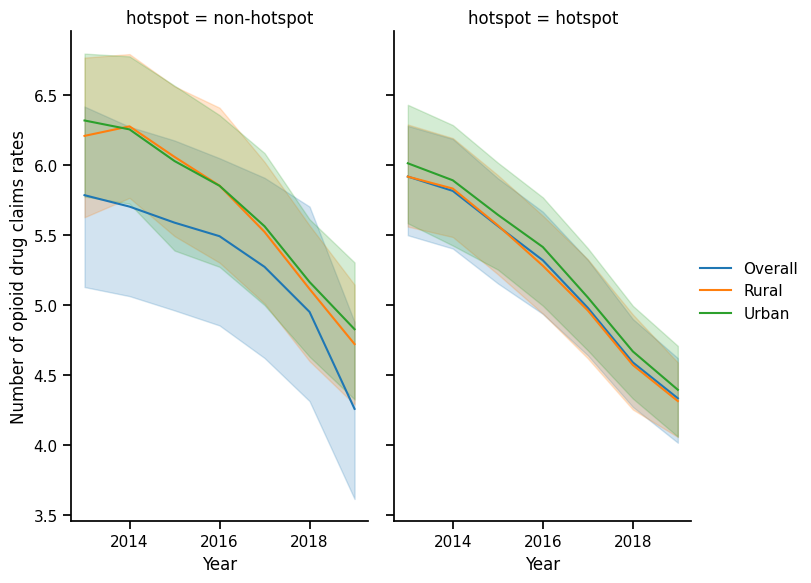

In [15]:
# Define column to plot name mapping for loop
columns_2_plot_name = {
    "Tot_Prscrbrs": "Number of providers prescribing drugs",
    "Tot_Opioid_Prscrbrs": "Number of providers prescribing opioid drugs",
    "Tot_Clms": "Number of drug claims",
    "Tot_Opioid_Clms": "Number of opioid drug claims",
    "Opioid_Prscrbng_Rate": "Number of opioid drug claims rates"
    }

# Plot each trend for hot spot and non hot spot states
for column, plot_name in columns_2_plot_name.items():
    g = sns.FacetGrid(prescribers, col="hotspot", col_wrap=2, height=6, aspect=0.6)
    g.map_dataframe(sns.lineplot, x="Year", y=column, hue="Breakout")
    for ax in g.axes.flat:
        ax.set_ylabel(plot_name.capitalize())
    g.add_legend()
    plt.show()
    print("\n\n")

Looking at the figures, we can see the following:

- Number of providers prescribing drugs is higher in hot spot states and trend is rising in both hot spot and non hot spot states.

- Number of providers prescribing opioid drugs is higher in hot spot states and trend is stable in both hot spot and non hot spot states.

- Number of drug claims is higher in hot spot states and trend is rising in both hot spot and non hot spot states.

- Number of opioid drug claims is higher in hot spot states and trend is decreasing in both hot spot and non hot spot states.

- Number of opioid drug claims rates is comparable and trend is decreasing in both hot spot and non hot spot states.

Also we see that the trend is the same in hot spots and non hot spots when looking at Urban vs Rural.

## ***ChatGPT prompts i used for this question***

- If you needed to build a solution with not limitation on resources (money, labour work, time, computational resources) how would you build a system for the following problem: "Find a way to describe the spread of the opioid epidemic in the country. (1) Identifying the location of hotspots in the country suffering from the epidemic and displaying them on a map. (2) Presentation of demographic changes in the country in areas affected by the epidemic. (3) Analyze the change in the level of crime and unemployment in areas that suffered from the epidemic (compared to areas that were not affected). (4) Analysis of the prescriptions given and how they changed over time."

- How can we visualize the change in crime and unemployment in US state if we have data?

- how would you analyze crime and unemployment in hot spots vs non hot spots?

- seaborn facetgrid labels on y-axis are overlapping, how to fix?

- sns.FacetGrid sort values in bar plot by value?

- what are states demographics?

- given data of deaths by year how can i define countries that are really suffering from deaths?

- how can i tell if a slope is statistically significant given multiple slopes?

# ***Question 2***

## ***Unlimited resources solution to the problem - verbal explanation***

If I had unlimited resources (money, labour, computing, etc.) I would suggest the following solution.


Data is the main issue in this question (as in all data science problems). Due to my unlimited labour force, I can create high-quality manual data. In order to construct the data, the following items will be included: (1) Preprocessed recipe names in clean text. (2) Preprocessed ingredients from a corpus of ingredients for consistency. (3) Preprocessed ingredient amounts based on well-defined amounts to ensure consistency. (4) Preprocessed free text directions on how to make the recipe without weird words or symbols. (5) Gender of the recipe writer.


Due to my unlimited computational resources, I can use all the data and run the most advanced techniques to gain insight into this dataset: (1) Using all the recipes, I would create a co-occurrence graph without limiting the number of vertices and edges. Then I would run cliques and communities with no limitations and present them using advanced visualisation.  (2) Human surveys would be used to define anomalies in ingredients and determine the effect they have on recipe rating. (3) In order to classify gender from our recipe data, I would create an advanced GPT based on our recipe data.


During my proof of concept, I will use a public dataset that has everything I need, but the quality is lower than our hypothetical dataset, and gender is not present and must be inferred. As in our hypothetical case, I will run algorithms and limit them due to a lack of resources but try to get as much information as possible.


## ***Section 2.0 - Dataset***

In order to answer this question, I selected the recipe dataset from the following source: [AllRecipes Scraper](https://github.com/shaansubbaiah/allrecipes-scraper/tree/main/export). A total of 35,516 recipes scraped from [Allrecipes](www.allrecipes.com) up until 2021 are included in the data.

Let's read the data:

In [16]:
# Read data from github
# Note: we can also use the tool to scrape new data
recipes_csv_url = (
    "https://raw.githubusercontent.com/shaansubbaiah/allrecipes-"
    "scraper/main/export/scraped-07-05-21.csv")
recipes_df = pd.read_csv(recipes_csv_url)

## ***Section 2.1 - Process & Visualization***

Because we want recipes with rating, let’s remove all recipes with no ratings:

In [17]:
# Remove recipes with no rating
recipes_df = recipes_df[recipes_df.rating != 0]

Next, let's look at the of missing values in each column:

Nullity matrix of the data:



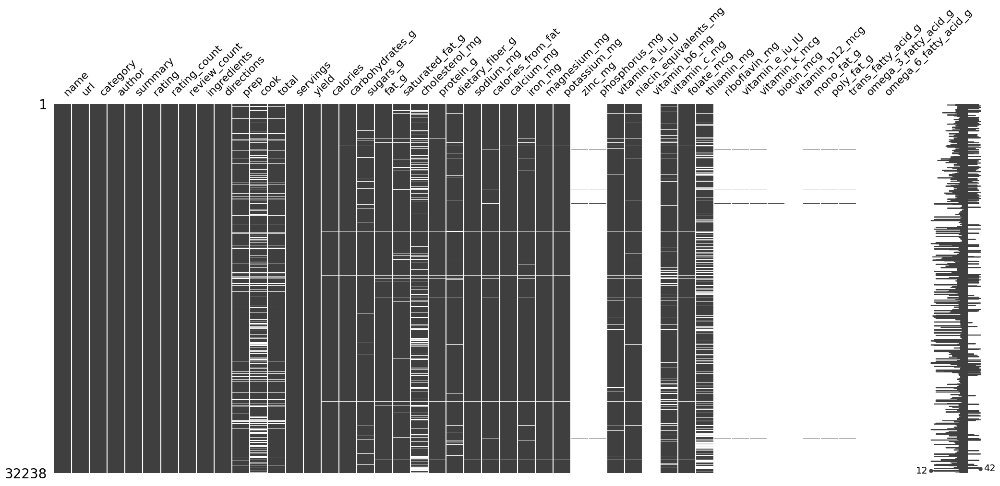

In [18]:
# Visualize missing values in each column
print("Nullity matrix of the data:", end="\n\n")
ax = msno.matrix(recipes_df)

Looking at the missing values we can see multiple columns that are redundant because they have to much missing values, let's remove them:

Nullity matrix of the data after removing columns:



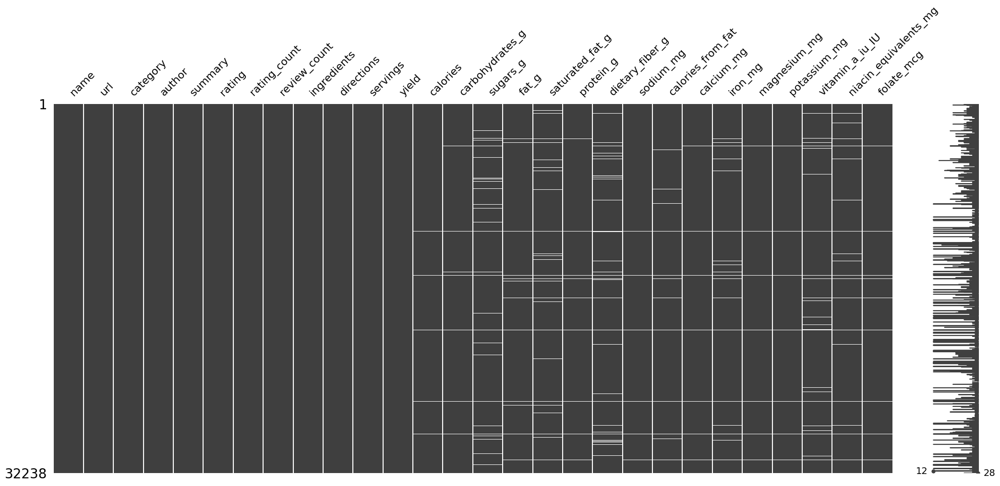

In [19]:
# Remove columns that are redundant because of missing values
recipes_df.drop(["cook", "cholesterol_mg", "zinc_mg", "phosphorus_mg",
                 "vitamin_b6_mg", "vitamin_c_mg", "thiamin_mg", "riboflavin_mg",
                 "vitamin_e_iu_IU", "vitamin_k_mcg", "biotin_mcg",
                 "vitamin_b12_mcg", "mono_fat_g", "poly_fat_g",
                 "trans_fatty_acid_g", "omega_3_fatty_acid_g",
                 "omega_6_fatty_acid_g", "prep", "total"], inplace=True, axis=1)
# Visualize missing values in each column
print("Nullity matrix of the data after removing columns:", end="\n\n")
ax = msno.matrix(recipes_df)

Next, let's remove all rows with missing values because there a not a lot of them and we have enough data:

In [20]:
# Remove missing values by row
print(f"Shape before removing missing value rows {recipes_df.shape}")
recipes_df.dropna(axis=0, inplace=True)
print(f"Shape after removing missing value rows {recipes_df.shape}")

Shape before removing missing value rows (32238, 28)
Shape after removing missing value rows (28998, 28)


Next, let's visualize the number of recipes by category:

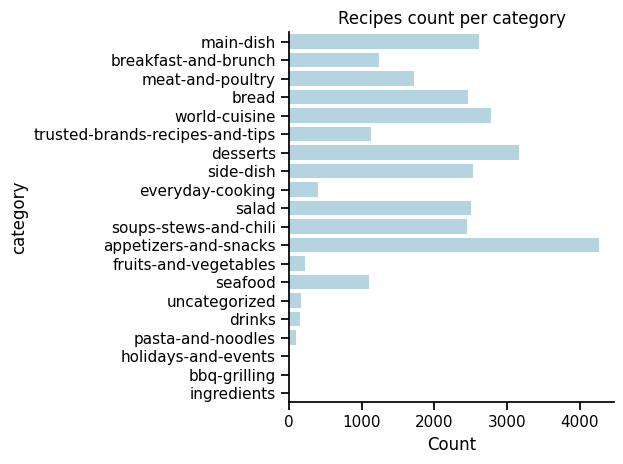

In [21]:
# Plot the number of recipes by category:
sns.countplot(y=recipes_df["category"], color="lightblue")
plt.title("Recipes count per category")
plt.xlabel("Count")
plt.ylabel("category")
sns.despine()
plt.tight_layout()
plt.show()

We can see some categories have a single recipes and we have some weird categories, let's remove them:

In [22]:
# Remove categories
recipes_df = recipes_df[(recipes_df.category != "ingredients")]
recipes_df = recipes_df[(recipes_df.category != "holidays-and-events")]
recipes_df = recipes_df[(recipes_df.category != "bbq-grilling")]
recipes_df = recipes_df[(recipes_df.category != "uncategorized")]

Next, let's print the rating by category:

In [23]:
print("Average rating by category:")
recipes_df.groupby(by='category').agg({'rating': 'mean'}).sort_values(by="rating", ascending=False)

Average rating by category:


,rating
category,
fruits-and-vegetables,4.524529
desserts,4.482504
drinks,4.478462
side-dish,4.475855
soups-stews-and-chili,4.474135
meat-and-poultry,4.457725
trusted-brands-recipes-and-tips,4.457529
world-cuisine,4.451267
breakfast-and-brunch,4.451174


Next, let's visualize the most popular authors:

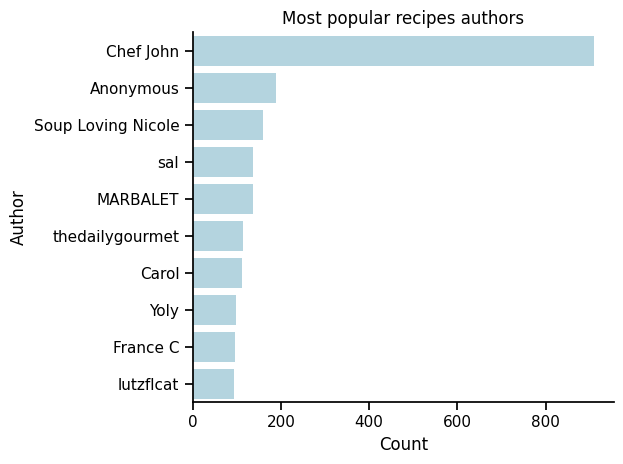

In [24]:
# Plot the most popular authors
most_popular_authors = recipes_df.groupby(by='author').size().sort_values(ascending=False)
sns.barplot(y=most_popular_authors[:10].index, x=most_popular_authors[:10].values, color="lightblue")
plt.title("Most popular recipes authors")
plt.xlabel("Count")
plt.ylabel("Author")
sns.despine()
plt.tight_layout()
plt.show()

Next, let's visualize one of the most popular authors:

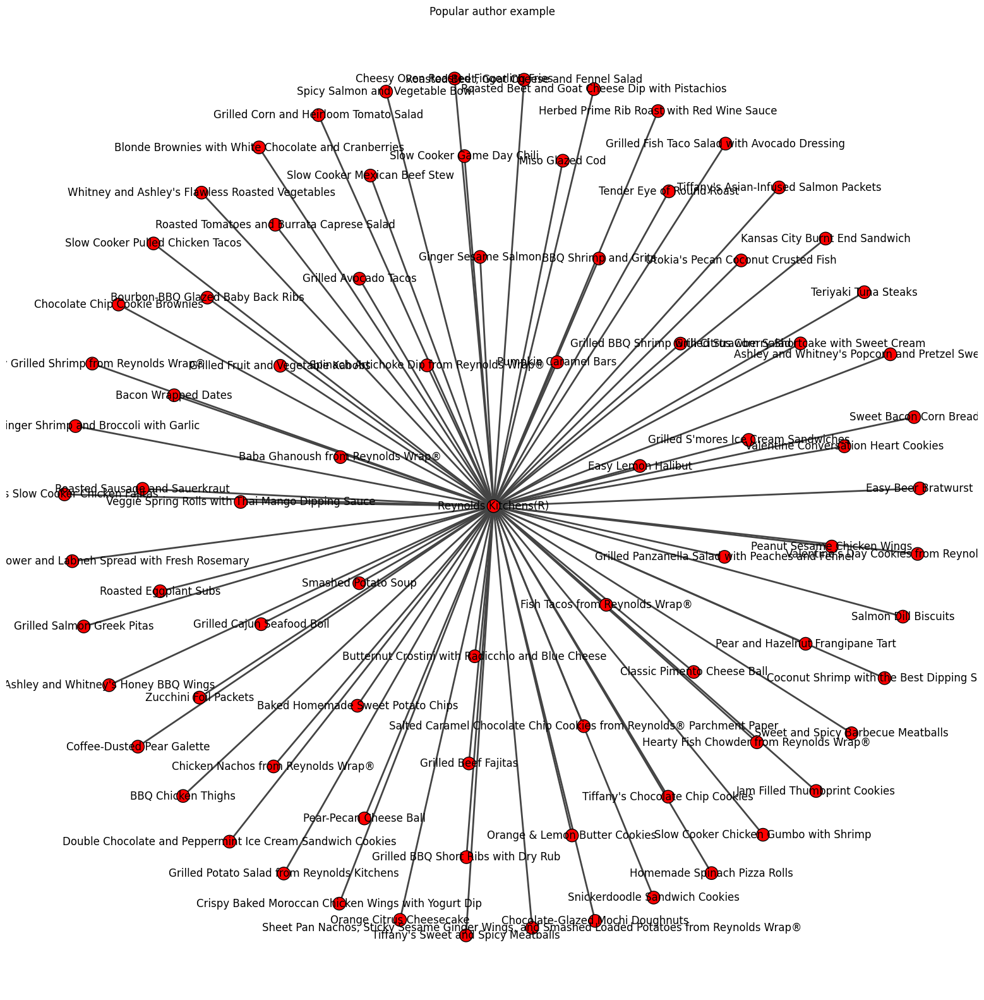

In [25]:
# Plot one of the most popular authors
most_popular_author = recipes_df[recipes_df.author == most_popular_authors.index[10]]
G = ig.Graph.TupleList(most_popular_author[["author", "name"]].to_numpy(), directed=False, weights=False)
fig, ax = plt.subplots(figsize=(20,20))
ig.plot(G, layout=G.layout_kamada_kawai(),
        vertex_label=G.vs["name"], target=ax)
plt.title("Popular author example")
plt.show()

Next, let's parse the ingredients using the [ingredient-parser-nlp](https://github.com/strangetom/ingredient-parser/) package:

In [26]:
# Remove non-alphanumeric chars from string and make lower case
regex = re.compile(r'[^\w\s,]')
recipes_df["ingredients_clean"] = recipes_df["ingredients"].progress_apply(
    lambda x: [regex.sub(" ", i).lower() for i in x.split(";")])

# Get ingredients from each recipe using ingredient-parser-nlp
recipes_df["ingredients_clean"] = recipes_df["ingredients_clean"].progress_apply(
    lambda x: [parse_ingredient(
        parse_ingredient(i)["name"])["name"] for i in x])

  0%|          | 0/28835 [00:00<?, ?it/s]

  0%|          | 0/28835 [00:00<?, ?it/s]

Next, let's visualize the most popular ingredients:

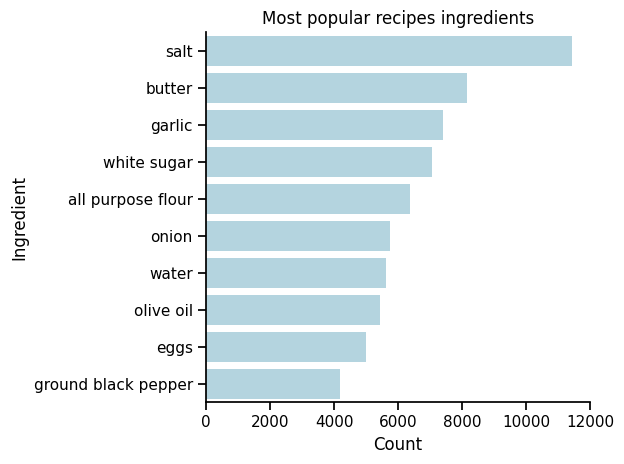

In [27]:
# Plot most popular ingredients
recipes_df["ingredients_clean"].explode()
most_popular_ingredients = recipes_df["ingredients_clean"].explode().value_counts().sort_values(ascending=False)
sns.barplot(y=most_popular_ingredients[:10].index, x=most_popular_ingredients[:10].values, color="lightblue")
plt.title("Most popular recipes ingredients")
plt.xlabel("Count")
plt.ylabel("Ingredient")
sns.despine()
plt.tight_layout()
plt.show()

Next, let's visualize the distribution of recipes directions length:

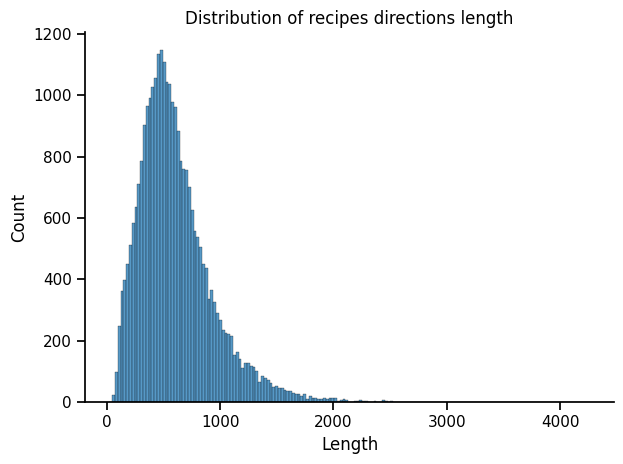

In [28]:
# Plot the distribution of recipes directions length
recipes_directions_lens = recipes_df.directions.str.len()
sns.histplot(data=recipes_df.directions.str.len())
plt.title("Distribution of recipes directions length")
plt.xlabel("Length")
plt.ylabel("Count")
sns.despine()
plt.tight_layout()
plt.show()

Next, let's visualize the distribution of recipes name length:

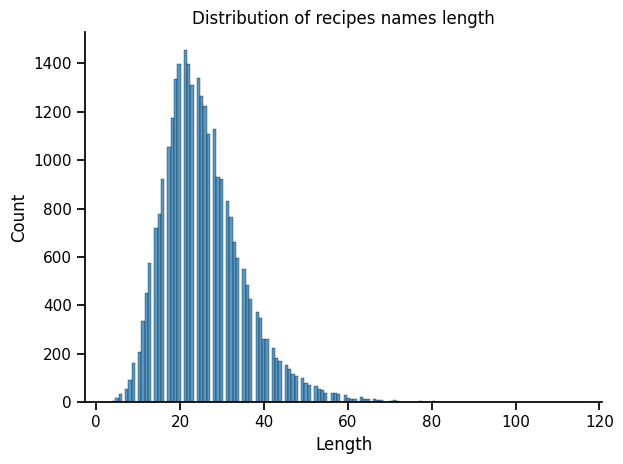

In [29]:
# Plot the distribution of recipes name length
recipes_directions_lens = recipes_df.name.str.len()
sns.histplot(data=recipes_df.name.str.len())
plt.title("Distribution of recipes names length")
plt.xlabel("Length")
plt.ylabel("Count")
sns.despine()
plt.tight_layout()
plt.show()

Next, let's visualize the distribution ratings:

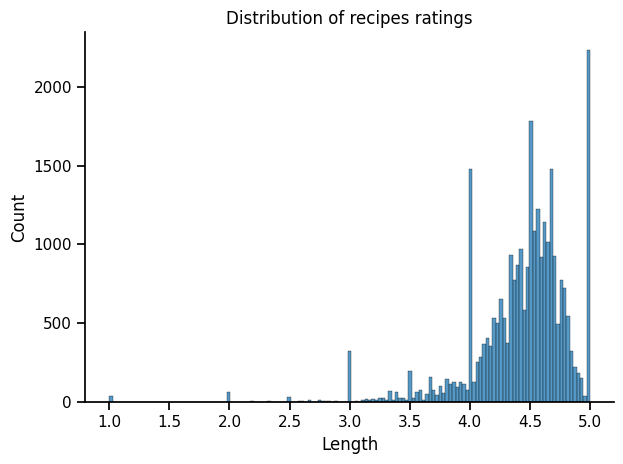

In [30]:
# Plot the distribution ratings
sns.histplot(data=recipes_df, x="rating")
plt.title("Distribution of recipes ratings")
plt.xlabel("Length")
plt.ylabel("Count")
sns.despine()
plt.tight_layout()
plt.show()

Next, let's visualize a wordcloud of the recipes names:

Recipes names wordcloud:



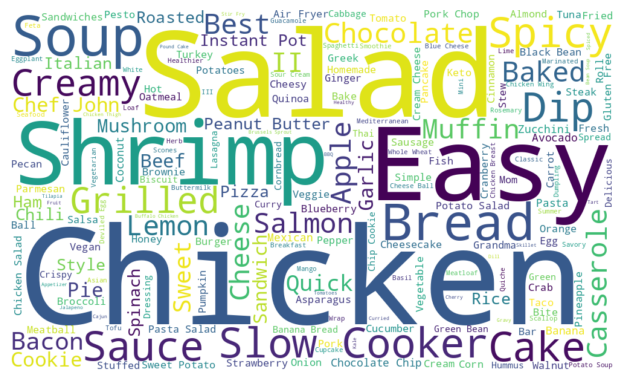

In [31]:
# Plot wordcloud of the recipes names
print("Recipes names wordcloud:", end="\n\n")
wordcloud = WordCloud(width=1000, height=600, background_color="white")
wordcloud.generate(" ".join(recipes_df.name.tolist()))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.tight_layout()
plt.show()

## ***Section 2.2 - Cliques & Communities***

Let's create a graph linking different ingredients in all recipes:

In [32]:
# Get ingredients edges (appear together) weights (number of appearances)
ingredients_weights = {}
for index, row in recipes_df.iterrows():
    for ing_1, ing_2 in list(itertools.combinations(row.ingredients_clean, 2)):
        ingredients_weights[(ing_1, ing_2)] = ingredients_weights.get((ing_1, ing_2), 0) + 1
# Sort ingredients weighted edges
weighted_edges = sorted([(*item, key) for item, key in ingredients_weights.items()], key=itemgetter(2), reverse=True)
# Create the igraph object
# We limit the graph due to memory limits in colab
G = ig.Graph.TupleList(weighted_edges[:50000], directed=False, weights=True)

Next, let's get find cliques in the graph:

In [33]:
# Find maximal cliques in the graph
cliques = G.maximal_cliques()

Next, let's plot distribution of the clique sizes:

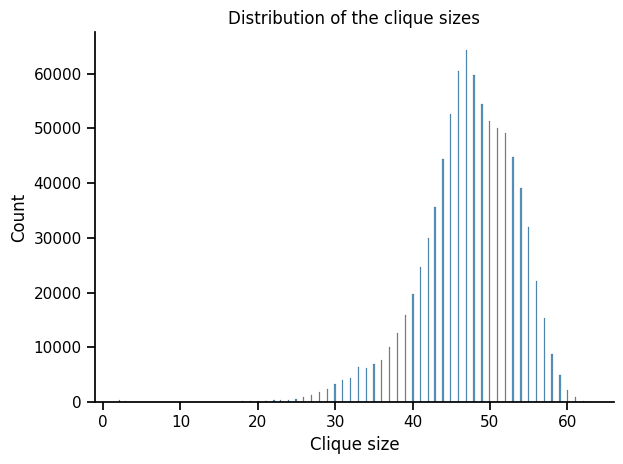

In [34]:
# Plot distribution of the clique sizes
sns.histplot(data=[len(clique) for clique in cliques])
plt.xlabel("Clique size")
plt.title("Distribution of the clique sizes")
sns.despine()
plt.tight_layout()
plt.show()

Next, let's plot top reappearing ingredient in cliques:

  0%|          | 0/856861 [00:00<?, ?it/s]

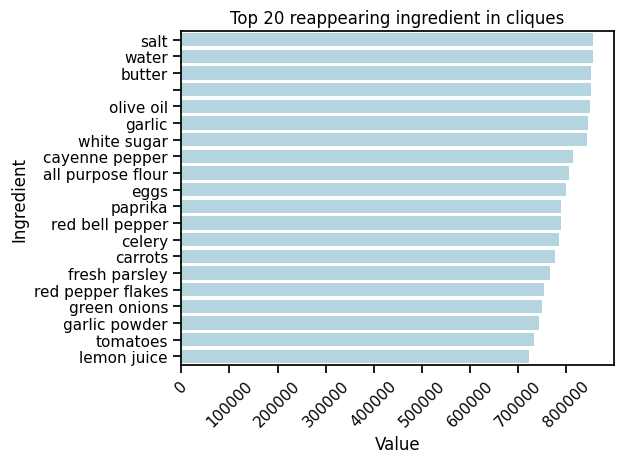

In [35]:
# Get ingredient in cliques and their reappearance count
cliques_ingredients_count = {}
for clique in tqdm(cliques):
    for ingredient in G.subgraph(clique).vs["name"]:
        cliques_ingredients_count[ingredient] = cliques_ingredients_count.get(
            ingredient, 0) + 1
cliques_ingredients_count = sorted(cliques_ingredients_count.items(),
                                   key=lambda x: x[1], reverse=True)
# Plot top reappearing ingredient in cliques
top_k = 20
ingredient_names = []
ingredient_values = []
for item, value in cliques_ingredients_count[:top_k]:
    ingredient_names.append(item)
    ingredient_values.append(value)
sns.barplot(x=ingredient_values, y=ingredient_names, color='lightblue')
plt.title(f"Top {top_k} reappearing ingredient in cliques")
plt.xlabel("Value")
plt.xticks(rotation = 45)
plt.ylabel("Ingredient")
plt.tight_layout()
plt.show()

Next, let's plot ingredients in cliques wordcloud:

Ingredients in cliques wordcloud:



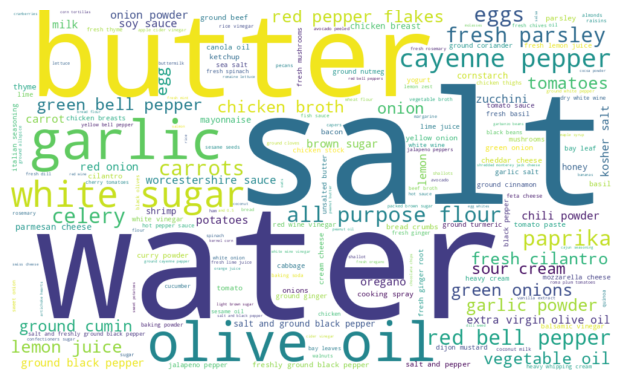

In [36]:
# Plot ingredients in cliques wordcloud
print("Ingredients in cliques wordcloud:", end="\n\n")
wordcloud = WordCloud(width=1000, height=600, background_color="white")
wordcloud.generate_from_frequencies(dict(cliques_ingredients_count))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.tight_layout()
plt.show()

Next, let's print largest clique:

In [37]:
# Print largest clique
largest_clique = G.largest_cliques()[0]
largest_clique_size = len(largest_clique)
largest_clique_graph = G.subgraph(largest_clique)
print(f"Largest clique with {largest_clique_size} vertices:")
pprint(", ".join(largest_clique_graph.vs["name"]))

Largest clique with 63 vertices:
('all purpose flour, salt, white sugar, ground black pepper, olive oil, '
 'garlic, onion, butter, eggs, water, milk, vegetable oil, egg, tomatoes, salt '
 'and ground black pepper, parmesan cheese, ground cumin, oregano, celery, '
 'fresh parsley, chicken broth, red pepper flakes, garlic powder, green bell '
 'pepper, soy sauce, cayenne pepper, cheddar cheese, lemon juice, fresh '
 'cilantro, , cream cheese, carrots, basil, worcestershire sauce, potatoes, '
 'extra virgin olive oil, paprika, onion powder, shrimp, chili powder, green '
 'onions, sour cream, red bell pepper, lemon, cornstarch, cooking spray, '
 'tomato paste, thyme, bacon, red onion, parsley, white vinegar, kosher salt, '
 'ketchup, chicken breast, carrot, bread crumbs, zucchini, fresh mushrooms, '
 'tomato, dijon mustard, sea salt, green onion')


Next, let's find communities in the graph:

In [38]:
# Find communities in the graph
communities = G.community_infomap()

Next, let's plot distribution of the community sizes:

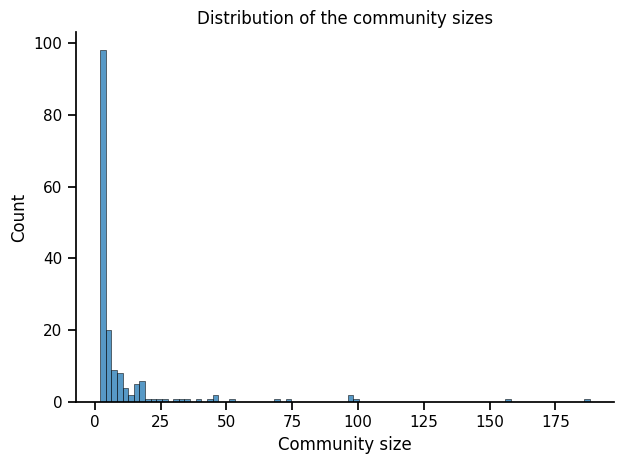

In [39]:
# Plot distribution of the community sizes
sns.histplot(data=[len(community) for community  in communities])
plt.xlabel("Community size")
plt.title("Distribution of the community sizes")
sns.despine()
plt.tight_layout()
plt.show()

Next, let's plot a single community:

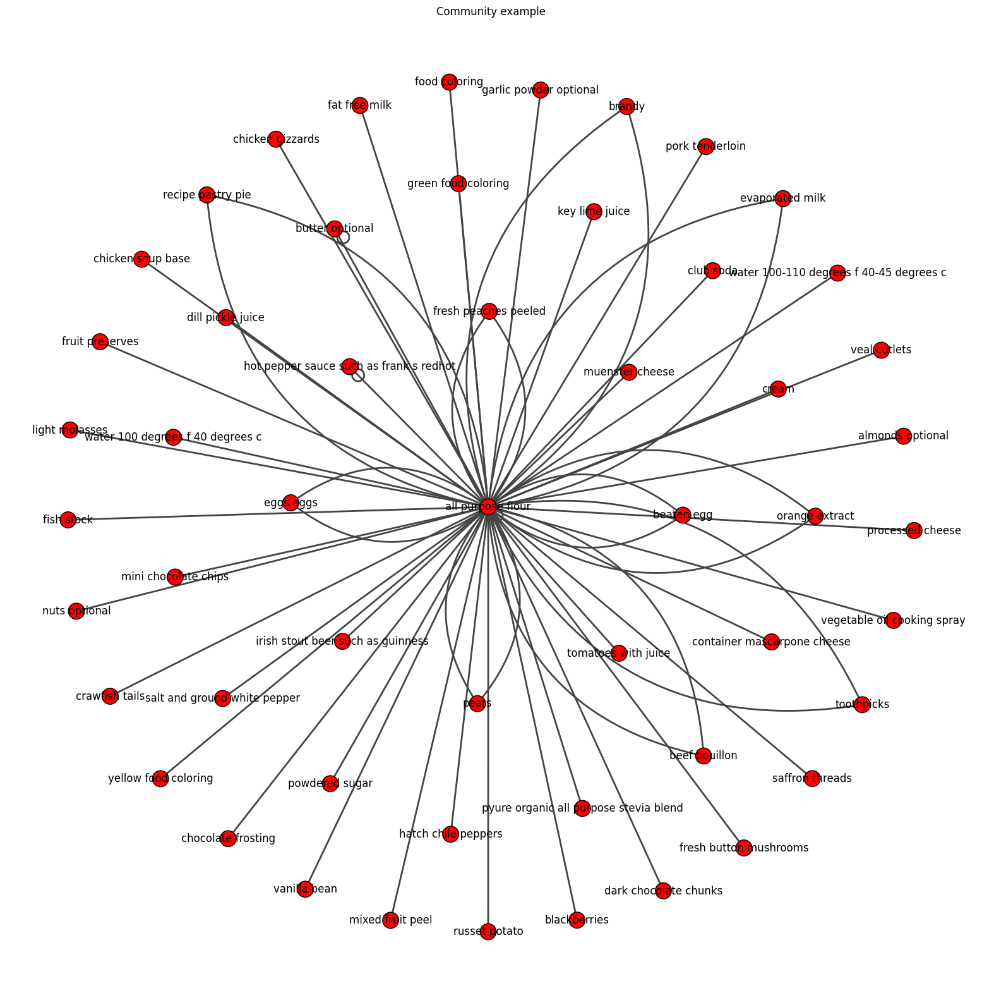

In [40]:
# Plot community
community_graph = G.subgraph(communities[0])
fig, ax = plt.subplots(figsize=(20,20))
ig.plot(community_graph, layout=community_graph.layout_kamada_kawai(),
        vertex_label=community_graph.vs["name"], target=ax)
plt.title("Community example")
plt.show()

## ***Section 2.3 - Anomalies***

I define anomalies as vertices that have all their neighbors connected with an edge weight of 1. And their rank is the number of neighbors. The reason for this definition is that a ingredient that has a lot of co-ingredients that only appears once with them is weird and therefore an anomaly.

Let's get all the anomalies.

In [41]:
# Create graph with all recipes
G = ig.Graph.TupleList(weighted_edges, directed=False, weights=True)

# Get all vertices that have all their neighbors connected with an edge
# weight of 1 which we define as anomalies. Also we get the number of
# neighbors to rank the anomalies.
anomalies = []
for vertex in G.vs:
    neighbors = vertex.neighbors(mode=ig.ALL)
    if all(G.es[G.get_eid(vertex.index, neighbor.index)]['weight'] ==
           1 for neighbor in neighbors):
        anomalies.append((vertex['name'], len(neighbors)))

# Sort anomalies by number of neighbors. Anomalies that have more neighbors
# meaning they have a lot of ingredients which they appear with them only once
# are ranked higher
anomalies = sorted(anomalies, key=lambda x: x[1], reverse=True)

# Print top ingredient anomalies
pprint(f"Top 10 ingredient anomalies {[i[0] for i in anomalies[:10]]}")

# Print bottom ingredient anomalies
pprint(f"Bottom 10 ingredient anomalies {[i[0] for i in anomalies[-10:]]}")

("Top 10 ingredient anomalies ['gala apple', 'green onions with tops', "
 "'horseradish sauce', 'anise seeds', 'tomatoes such as san marzano', 'vanilla "
 "bean paste', 'halloumi cheese', 'sucanat', 'fresh hot chile peppers', 'green "
 "tomato']")
("Bottom 10 ingredient anomalies ['dry sweetened cereal', 'cheese product', "
 "'cherry flavored jell o mix', 'sour cream such as breakstone s', 'almond "
 "bark', 'red gold petite diced tomatoes green chilies', 'prepared cheese "
 "product', 'tomatoes chiles', 'oyster mushroom caps', 'potato s peelings']")


We can see that the top ingredients are really anomalies for example : "X". The bottom ingredients are not really anomalies but bad processed ingredients.

Let's get all the recipes with anomalies:

In [42]:
# Get recipes with anomalies. We know each recipe can only have one anomaly
# ingredient
anomalies_names = [i[0] for i in anomalies]
anomalous_recipes_idx = []
non_anomalous_recipes_idx = []
for index, row in tqdm(recipes_df.iterrows(), total=recipes_df.shape[0]):
    if len(np.intersect1d(row.ingredients_clean, anomalies_names)) > 0:
        anomalous_recipes_idx.append(index)
    else:
        non_anomalous_recipes_idx.append(index)

  0%|          | 0/28835 [00:00<?, ?it/s]

Next, let's order the recipes with anomalies:

In [43]:
# Order the recipes with anomalies
anomalies = dict(anomalies)
anomalous_recipes = recipes_df.loc[anomalous_recipes_idx].copy()
anomalous_recipes["position"] = anomalous_recipes["ingredients_clean"].apply(
    lambda ingredients: max([anomalies.get(ingredient, 0) for ingredient in ingredients])
)
anomalous_recipes.sort_values(by="position", ascending=False)

,name,url,category,author,summary,rating,rating_count,review_count,ingredients,directions,...,calories_from_fat,calcium_mg,iron_mg,magnesium_mg,potassium_mg,vitamin_a_iu_IU,niacin_equivalents_mg,folate_mcg,ingredients_clean,position
17107,Morgan's Waldorf Salad,https://www.allrecipes.com/recipe/221020/morga...,salad,Morgan,The idea of Waldorf salad was unappealing to m...,4.80,56,43,"1 Granny Smith apple, cubed ; 1 Golden Delic...","Combine Granny Smith apple, Golden Delicious a...",...,267.4,58.3,0.6,26.4,233.8,376.4,0.9,22.9,"[granny smith apple, golden delicious apple, g...",55
29750,Morning Fruit Bowl,https://www.allrecipes.com/recipe/244626/morni...,salad,islandcook82,"This is a very healthy breakfast, for when you...",5.00,1,1,1 cup Greek yogurt ; 2 tablespoons coconut oil...,"Stir yogurt, coconut oil, and agave nectar tog...",...,464.3,101.7,2.7,93.9,452.9,835.0,4.1,61.0,"[greek yogurt, coconut oil, agave nectar, oats...",55
21637,Christine's Bacon and Brussels Sprout Cranberr...,https://www.allrecipes.com/recipe/240264/chris...,salad,Christine Folkes,Wonderful quick and healthy warm salad that ca...,4.33,3,3,"½ pound thick-cut bacon, cut into 1-inch chunk...",Place bacon in a wok or large skillet; cook an...,...,140.5,65.9,2.1,49.5,607.9,1019.0,5.0,71.8,"[thick cut bacon, brussels sprouts, cranberrie...",55
3027,Chicken Salad with Grapes and Apples,https://www.allrecipes.com/recipe/232744/chick...,salad,aravis121,"Delicious, fruity chicken salad!",4.60,45,32,2 tablespoons mayonnaise ; 1 cup cubed cooked ...,"Mix mayonnaise, chicken, grapes, apple, onion,...",...,70.3,15.5,0.5,11.0,182.5,87.4,3.3,6.3,"[mayonnaise, chicken, grapes, gala apple, red ...",55
4618,Apple Banana Smoothie,https://www.allrecipes.com/recipe/20610/apple-...,breakfast-and-brunch,Jim Wohlgemuth,"Thick and healthy fruit drink with apple, bana...",4.06,136,110,"1 frozen bananas, peeled and chopped ; ½ cup ...","In a blender combine frozen banana, orange jui...",...,9.3,49.6,0.4,29.6,454.8,256.7,1.0,34.0,"[bananas, orange juice, gala apple, milk]",55
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29061,Captain Crunch Chicken,https://www.allrecipes.com/recipe/15128/captai...,meat-and-poultry,Terrie,This is a 'sweet' change from the same old bre...,3.81,72,59,"4 skinless, boneless chicken breasts ; 5 cups...",Preheat oven to 350 degrees F (175 degrees C)....,...,29.7,16.4,6.9,49.9,358.7,70.7,25.4,490.7,"[chicken breasts, dry sweetened cereal]",1
31039,Candied Almond Bark Popcorn,https://www.allrecipes.com/recipe/260870/candi...,desserts,alytholen,A yummy twist on normal buttered popcorn that ...,5.00,3,1,1 (24 ounce) package almond bark ; 3 (2.9 ounc...,Place packaged popcorn in the microwave; cook ...,...,101.0,13.8,1.4,31.0,156.5,21.6,0.4,4.1,"[almond bark, microwave popcorn]",1
30372,Frosted Grapes,https://www.allrecipes.com/recipe/100089/frost...,appetizers-and-snacks,CookBakeGrill,These are so wonderful. Made with flavored gel...,4.29,105,82,2 pounds red seedless grapes ; 1 (3 ounce) pac...,Pluck grapes from their stems and rinse in a c...,...,5.9,12.5,0.3,6.8,210.0,82.9,0.4,4.5,"[grapes, cherry flavored jell o mix]",1
30284,Chili Cheese Dip from Hormel® Chili,https://www.allrecipes.com/recipe/240377/chili...,trusted-brands-recipes-and-tips,HORMEL CHILI(R),Whether you need a tailgating triumph or a sat...,4.50,26,23,1 (15 ounce) can HORMEL® Chili No Beans ; 1 (1...,"In medium microwave-safe bowl, stir together c...",...,178.7,309.1,0.1,15.1,94.6,538.2,3.0,4.5,"[hormel chili no beans, cheese product]",1


Next, let's look if anomalous recipes have lower rating than non-anomalous recipes:

In [44]:
# Print anomalous recipes vs non-anomalous recipes rating
anomalous_recipes_mean_rating = round(recipes_df.loc[anomalous_recipes_idx].rating.mean(),3)
anomalous_recipes_std_rating = round(recipes_df.loc[anomalous_recipes_idx].rating.std(),3)
non_anomalous_recipes_mean_rating = round(recipes_df.loc[non_anomalous_recipes_idx].rating.mean(),3)
non_anomalous_recipes_std_rating = round(recipes_df.loc[non_anomalous_recipes_idx].rating.std(),3)
print(f"Anomalous recipes rating (mean+-std): {anomalous_recipes_mean_rating}+-{anomalous_recipes_std_rating}")
print(f"Non-anomalous recipes rating (mean+-std): {non_anomalous_recipes_mean_rating}+-{non_anomalous_recipes_std_rating}")

Anomalous recipes rating (mean+-std): 4.441+-0.487
Non-anomalous recipes rating (mean+-std): 4.419+-0.425


## ***Section 2.4 - Gender classification***

Because our data does not contain gender labels we will infer them from the user name using a pretrained name to gender model:

In [45]:
# Load pre-trained tokenizer and model
tokenizer = AutoTokenizer.from_pretrained("datalearningpr/name_to_gender")
model = AutoModelForSequenceClassification.from_pretrained(
    "datalearningpr/name_to_gender").to("cuda")

# Define the chunk size
chunk_size = 512

# Calculate the number of chunks
num_chunks = (len(recipes_df) + chunk_size - 1) // chunk_size

# Group the DataFrame by chunks
groups = recipes_df.groupby(recipes_df.index // chunk_size)

# Define function to classify gender from names
def classify_gender(names):
    # Tokenize the names
    inputs = tokenizer(names, padding=True, truncation=True,
                       return_tensors="pt", max_length=32).to('cuda')

    # Perform the classification
    outputs = model(**inputs)
    logits = outputs.logits
    predicted_classes = torch.argmax(logits, dim=1)
    # Return labels 0 is male 1 is female
    return [0 if predicted_class == 0 else 1 for
            predicted_class in predicted_classes]

# Loop over the groups and get genders
genders = []
for group_key, group_df in tqdm(groups):
    genders += classify_gender(group_df["author"].to_list())
    gc.collect()

  0%|          | 0/70 [00:00<?, ?it/s]

Next, let's get the same number of female and male recipes:

In [46]:
# Get same number of male and female recipes
male_idx = recipes_df.iloc[np.where(np.array(genders) ==0)[0]].index
female_idx = recipes_df.iloc[np.where(np.array(genders) == 1)[0]].index
female_idx = np.random.choice(female_idx, size=len(male_idx))
# Assign the gender value
recipes_df.loc[male_idx, "gender"] = 0
recipes_df.loc[female_idx, "gender"] = 1
# Get only rows with gender
gender_df = recipes_df.loc[np.concatenate((male_idx, female_idx))]

Next, let's get the recipes embeddings:

In [47]:
# Load the pre-trained RoBERTa tokenizer and model
tokenizer = RobertaTokenizer.from_pretrained('roberta-base')
model = RobertaModel.from_pretrained('roberta-base').to('cuda')

# Define function to embeddings of text
def get_embeddings(text, tokenizer, model):
    # Tokenize the text and prepare it to be input to the model
    tokens = tokenizer.encode(text, add_special_tokens=True)
    tokens_tensor = torch.tensor(tokens).unsqueeze(0).to('cuda')

    # Get the RoBERTa model's output for the text
    outputs = model(tokens_tensor)

    # Extract the last hidden state of the RoBERTa model output
    last_hidden_state = outputs.last_hidden_state

    # Get the vector embeddings for the tokens in the text
    return last_hidden_state.squeeze(0).detach().cpu().numpy()

# Get embeddings
vectors_list = []
texts = gender_df["directions"].apply(lambda t: t[:514]).values
for text in tqdm(texts):
    vectors_list.append(get_embeddings(text, tokenizer, model))
vectors_list2 = [v[0] for v in vectors_list]
cols = [f"Feature {i}" for i in range(len(vectors_list2[0]))]
v_df = pd.DataFrame(data = vectors_list2,columns=cols)
embeddings = v_df.values

Some weights of the model checkpoint at roberta-base were not used when initializing RobertaModel: ['lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.layer_norm.weight', 'lm_head.dense.bias', 'lm_head.dense.weight']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Some weights of RobertaModel were not initialized from the model checkpoint at roberta-base and are newly initialized: ['roberta.pooler.dense.weight', 'roberta.pooler.dense.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


  0%|          | 0/3604 [00:00<?, ?it/s]

Next let's build the model and evaluate it:

Accuracy: 0.606
ROC-AUC: 0.605



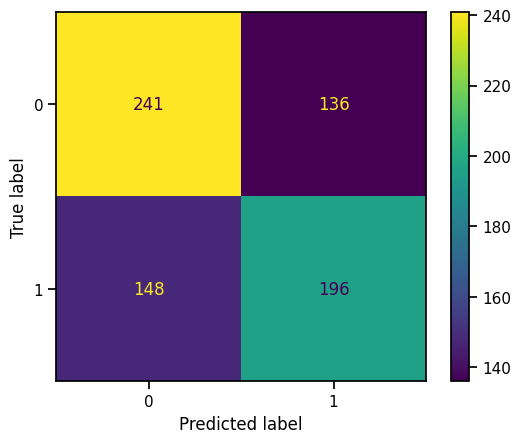

In [48]:
# Train test split
X_train, X_test, y_train, y_test = train_test_split(
    embeddings, gender_df['gender'].values.astype('int'),
    test_size=0.2, random_state=42)

# Train model and get predictions
clf = RandomForestClassifier(random_state=42, n_estimators=100, n_jobs=-1)
clf.fit(X_train, y_train)
y_predict = clf.predict(X_test)

# Evaluate predictions
print(f"Accuracy: {round(accuracy_score(y_test,y_predict), 3)}")
print(f"ROC-AUC: {round(roc_auc_score(y_test,y_predict),3)}", end="\n\n")
cm = confusion_matrix(y_test, y_predict, labels=clf.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                              display_labels=clf.classes_)
ax = disp.plot()
plt.show()

## ***ChatGPT prompts i used for this question***

- How to do this question in python : "Find cliques and communities of  graph and present the results in at least 3 graphical ways"
- Follow up question to previous question. This is very slow, any way to optimise? Maybe a different package?
- Plot of the graph is not visible. How can I change the layout?
- Given a recipe data that contains recipe, rating, username, category, how would you answer this question: “Analyse the database and present at least 5 different visualisations (networks, text analysis, etc.)”
- How to make an igraph plot more visible when showing vertices labels? The text is cut in a lot of places.
- Write code in python the given a igraph of recipes ingredient, finds recipes that have anomalies in one of the ingredients
- Find ingredients that appear once together in a igraph
- Find vertices that all their neighbours are with wight 1
- How to use a pre trained name to gender transformer in python for gender classification
- How to split a dataframe into chunks and loop over it?


# ***Question 3***

## ***Solution to the problem - verbal explanation***

To analyse and present the sequence of events that occurred after the death of Queen Elizabeth II. We need  to solve 4 sub problems:

1. Data - we need to gather data representing events that are related to the death of Queen Elizabeth II. Fortunately we can use GoogleNews in order to get related articles published from the date of death.

2. Data grouping - some articles retrieved by GoogleNews can be the same article or very close to one another and there is no need for both of them to represent an event. For this we can use an article's similarity to identify if two news articles represent the same information.

3. Data filtering - we need to filter articles that GoogleNews thinks are related to the death of Queen Elizabeth II but are not really an event but just a related article. For this we can use a Generative Pre-trained Transformers (GPT) fine tuned to identify if a news article is actually an event related to our main event.

4. Data visualisation - lastly after we have our events we need to present them. For this we can create a timeline figure showing the events.

In our prototype we will use a pre-trained GPT in a zero shot manner but all the other steps will be implemented as mentioned.


## ***Solution to the problem - POC***

Let's gather data representing events that are related to the death of Queen Elizabeth II:

In [49]:
# Get results from event data on the topic
event_date = "09/08/2022"
googlenews = GoogleNews(lang='en', start=event_date)

keywords = ["Elizabeth Alexandra Mary", "queen elizabeth ii",
            "queen elizabeth", "Elizabeth II","Queen of the United Kingdom",
            "Former Queen of the United Kingdom"]

# Iterate over the search results and retrieve articles
articles = []
for keyword in keywords:
    googlenews.get_news(keyword.lower())
    for article_meta in googlenews.results():
        articles.append([article_meta["datetime"], article_meta["title"]])

#
events = pd.DataFrame(articles, columns=["publish_date", "title"])
events.drop_duplicates("title", inplace=True)
events.dropna(inplace=True)

Let's filter articles representing the same information:

In [50]:
# Define function to process text
def preprocess_title(title):
    title = title.lower()
    title = re.sub(r'[^\w\s]', '', title)
    return title

# Define function to remove similar titles
def remove_similar_titles(titles, threshold=0.6):
    preprocessed_titles = [preprocess_title(title) for title in titles]

    vectorizer = TfidfVectorizer()
    title_vectors = vectorizer.fit_transform(preprocessed_titles)

    duplicate_indices = set()
    num_titles = len(preprocessed_titles)

    for i in range(num_titles):
        if i not in duplicate_indices:
            for j in range(i + 1, num_titles):
                if j not in duplicate_indices:
                    similarity_score = cosine_similarity(title_vectors[i], title_vectors[j])[0][0]
                    if similarity_score > threshold:
                        duplicate_indices.add(j)

    unique_titles = [titles[i] for i in range(num_titles) if i not in duplicate_indices]
    return unique_titles

# Get unique titles
unique_titles = remove_similar_titles(events.title.to_numpy())
# Filter title
events = events[events.title.isin(unique_titles)].sample(30)

Let's identify if a news article is actually an event related to our the death of Queen Elizabeth II:

In [51]:
# Define GPT prompt
prompt = (
    "Answer yes or no. Given the information that queen elizabeth ii died"
    " on September 8 2022. Is this title an event after her death?\nTitle: {0}"
    "\nAnswer:")

# Log in to huggingface and grant authorization to huggingchat
# Insert you details to run you can create free user in huggingchat
user_name = ""
password = ""
sign = Login(user_name, password)
cookies = sign.login()

# Create a ChatBot
chatbot = hugchat.ChatBot(cookies=cookies.get_dict())

# Loop over every title and get if its and event relevant
output = []
for index, row in tqdm(events.iterrows(), total=events.shape[0]):
    time.sleep(5)
    id = chatbot.new_conversation()
    chatbot.change_conversation(id)
    output.append(chatbot.chat(prompt.format(row.title)))

# Get relevant events
events["gpt-response"] = output
relevant_events = events[events["gpt-response"].str.lower().str.contains("yes")]

  0%|          | 0/30 [00:00<?, ?it/s]

Let's create a timeline figure showing the events:

In [52]:
# Plot events
fig = px.scatter(relevant_events, x='publish_date', y=np.ones(relevant_events.shape[0]),
                 title="", hover_name="title", labels={"publish_date": "Date", "y":""})
fig.update_xaxes(showgrid=False)
fig.update_yaxes(showgrid=False,
                 zeroline=True, zerolinecolor='black', zerolinewidth=3,
                 showticklabels=False)
fig.update_layout(height=200, plot_bgcolor='white')
fig.show()

## ***ChatGPT prompts i used for this question***

- given a list of news title how to remove similar news titles?

- given 100 news article how can we decide which one are the same topic?

- how to do topic modeling using transformers in python?

- pandas row wise similarity heatmap

- give me a function to test number significance given a number and list of numbers

- how so get news by title in python, is there a package?